<a href="https://colab.research.google.com/github/KancharlaSaiRam/Agriculture_crop_classification/blob/main/Sairam_appliedai_cs_2_basemodelling.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## 1.import required libraries

In [ ]:
import numpy as np
from numpy import asarray
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm # color map
import seaborn as sns

import os.path
from os import path

from google.colab import files

import matplotlib.pyplot as plt
import cv2 as cv
import cv2

# Import the necessary libraries
from PIL import Image
from skimage.io import imread

import tqdm 
from tqdm import tqdm

from sklearn.preprocessing import OneHotEncoder,LabelEncoder

import warnings
warnings.filterwarnings("ignore")

!pip3 install pydot
!pip3 install graphviz
from keras.utils.vis_utils import plot_model

import tensorflow as tf
tf.keras.backend.clear_session()
#from tf.keras.optimizers import SGD
from tensorflow import keras
from tensorflow.keras import layers

## 2.load data set

In [ ]:
# refernce how to load the dataset from the kaggle
# refer: https://www.analyticsvidhya.com/blog/2021/06/how-to-load-kaggle-datasets-directly-into-google-colab/
# load the json file from thee device
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"kancharlasairam","key":"6e753fde060715f5f40c889675ec7e5c"}'}

In [ ]:
def load_dataset():
  """
    this function is used to load the dataset based on my required format and folder.
  """
  if path.exists("/content/agriculture-crop-images.zip"):
    print("loaded the dataset...")
  else:
    ! pip install -q kaggle # install the kaggle library
    ! mkdir ~/.kaggle # create root directory
    ! cp kaggle.json ~/.kaggle/ #  Make directory named kaggle and copy kaggle.json file there.

    ! chmod 600 ~/.kaggle/kaggle.json # Change the permissions of the file.
    ! kaggle datasets download -d aman2000jaiswal/agriculture-crop-images # download the dataset with -d / competition with -c
  
  # for my comfort create the kaggle/input directory to unzip the files.

  if path.isdir('/kaggle/input'):  # check if the /kaggle/input exists or not?
  # if the folder is created already.
    if path.exists("/kaggle/input/Crop_details.csv"): # /content/kaggle/input/Crop_details.csv
      print("already existed and loaded...")
    else:
      # unzip the dataset
      # unzip the list of data from the drive list files
      # refer code: !unzip path_to_file.zip -d path_to_directory(destination)  
      print("unzip the dataset....")
      ! unzip /content/agriculture-crop-images.zip -d /kaggle/input
  else: # if the /kaggle/input is not created then create the folders.

      # create kaggle directory for my comfort
      ! mkdir /kaggle
      ! mkdir /kaggle/input
      # unzip the dataset
      print("unzip the dataset ....")
      ! unzip /content/agriculture-crop-images.zip -d /kaggle/input  # unzip the folder into the destination where you required.
  
  return None

In [ ]:
load_dataset() # loaded the dataset 

In [ ]:
load_dataset() # cross check once you loaded the dataset . 

loaded the dataset...
already existed and loaded...


In [ ]:
# cross check the folders and files
path.isdir('/kaggle')
path.exists("/kaggle/input/Crop_details.csv")
path.exists("/kaggle/input/crop_images/jute/jute002a.jpeg")

True

In [ ]:
path.exists("/kaggle/input/crop_images/wheat/wheat0002a.jpeg")

True

##3. dataset loader

In [ ]:
# load the cropdetails file that contains the 3 columns image path and crop name and crop label. we don't need Unnamed column so drop that.
df = pd.read_csv("/kaggle/input/Crop_details.csv",index_col=None).drop("Unnamed: 0",axis=1)
df.head(3)

,path,crop,croplabel
0,/kaggle/input/kag2/sugarcane/sugarcane037ahs.jpeg,sugarcane,3
1,/kaggle/input/kag2/sugarcane/sugarcane034a.jpeg,sugarcane,3
2,/kaggle/input/kag2/sugarcane/sugarcane032arot....,sugarcane,3


In [ ]:
# jute -0
# maize -1
# rice -2
# sugarcane-3
# wheat -4
from sklearn.model_selection import train_test_split
x = df["path"]
y = df["crop"]
#df1 = df[['path', 'croplabel']] # takes only the image and mask values
X_train, X_test,y_train,y_test = train_test_split(x,y,test_size=0.11, random_state=42,stratify=y)#dataset is less so takes the 90-10 ratio.
print("the shape of the train data : ",(X_train.shape,y_train.shape))
print("the shape of the test data : ",(X_test.shape,y_test.shape))

the shape of the train data :  ((889,), (889,))
the shape of the test data :  ((110,), (110,))


In [ ]:
from sklearn.preprocessing import OneHotEncoder
from scipy.sparse import csr_matrix

oh = OneHotEncoder()
y_train_oh = oh.fit_transform(y_train.values.reshape(-1,1))
y_train1 = csr_matrix.toarray(y_train_oh)

y_test_oh = oh.transform(y_test.values.reshape(-1,1))
y_test1 = csr_matrix.toarray(y_test_oh)
print("shape of the test data : ",y_test1.shape)
print("shape of the train data : ",y_train1.shape)

shape of the test data :  (110, 5)
shape of the train data :  (889, 5)


In [ ]:
def dataset_creation_pipeline(dataset):
    flat = [] # create an empty list to store the array formatted image.
    for i in tqdm(dataset):
        img = plt.imread(i) # read the image
        img = img/255. # normalize the image
        flat.append(img) # append into the list
    flat_array =  np.array(flat) # convert the list into the array 
    valued_img = flat_array.reshape(-1,224,224,3) # reshape the image into required format here I was used 224,224
    return valued_img
    

In [ ]:
# dataset be can created from the given image paths
dx_train = dataset_creation_pipeline(X_train)
dx_test = dataset_creation_pipeline(X_test)

100%|██████████| 110/110 [00:00<00:00, 510.20it/s]


In [ ]:
type(dx_train)

numpy.ndarray

In [ ]:
print("the no of trained images :",len(dx_train))
print("the shape of the  arrayed image : ",dx_train[0].shape)
print("the exmple image :")
print(dx_train[0])

the no of trained images : 889
the shape of the  arrayed image :  (224, 224, 3)
the exmple image :
[[[0.58431373 0.80784314 0.39607843]
  [0.50588235 0.72941176 0.31764706]
  [0.46666667 0.68627451 0.29019608]
  ...
  [0.49019608 0.70588235 0.34901961]
  [0.45098039 0.6627451  0.31764706]
  [0.40784314 0.61960784 0.28235294]]

 [[0.45882353 0.68235294 0.27058824]
  [0.42745098 0.65098039 0.23921569]
  [0.42745098 0.64705882 0.25098039]
  ...
  [0.52156863 0.7372549  0.38039216]
  [0.4627451  0.6745098  0.32941176]
  [0.41960784 0.63137255 0.29411765]]

 [[0.32156863 0.54509804 0.13333333]
  [0.34509804 0.56862745 0.15686275]
  [0.38039216 0.60392157 0.2       ]
  ...
  [0.5372549  0.75294118 0.38823529]
  [0.47058824 0.68235294 0.3372549 ]
  [0.47843137 0.69019608 0.35294118]]

 ...

 [[0.44313725 0.67058824 0.27843137]
  [0.45098039 0.67843137 0.28627451]
  [0.45490196 0.67843137 0.29803922]
  ...
  [0.31372549 0.51764706 0.19607843]
  [0.43137255 0.63529412 0.31372549]
  [0.57647059 

In [ ]:
print("the no of tested images :",len(dx_test))
print("the shape of the  arrayed image : ",dx_test[0].shape)
print("the exmple image :")
print(dx_test[0])

the no of tested images : 110
the shape of the  arrayed image :  (224, 224, 3)
the exmple image :
[[[0.14509804 0.15686275 0.23137255]
  [0.14509804 0.16862745 0.16862745]
  [0.15686275 0.19215686 0.11764706]
  ...
  [0.12156863 0.1254902  0.05490196]
  [0.12156863 0.1254902  0.05490196]
  [0.04313725 0.04313725 0.01176471]]

 [[0.1372549  0.14901961 0.21568627]
  [0.14509804 0.16862745 0.16862745]
  [0.15686275 0.19215686 0.1254902 ]
  ...
  [0.08627451 0.09019608 0.01960784]
  [0.09803922 0.10196078 0.03137255]
  [0.04705882 0.04705882 0.01568627]]

 [[0.12941176 0.14509804 0.19215686]
  [0.14901961 0.17254902 0.17254902]
  [0.16078431 0.19215686 0.14117647]
  ...
  [0.06666667 0.07058824 0.00784314]
  [0.07058824 0.0745098  0.01176471]
  [0.05490196 0.05490196 0.02352941]]

 ...

 [[0.17254902 0.20784314 0.14117647]
  [0.15294118 0.16862745 0.10980392]
  [0.18431373 0.17647059 0.1254902 ]
  ...
  [0.74117647 0.70196078 0.50196078]
  [0.83529412 0.78823529 0.58431373]
  [0.96078431 0

##4. base-models

In [ ]:
import tensorflow as tf

In [ ]:
# code is taken from the applied ai reference notebook
class TerminateNaN(tf.keras.callbacks.Callback):
  def on_epoch_end(self, epoch, logs={}):
    loss = logs.get('loss') # gets the loss value from the logs.
    if loss is not None:    # loss is not a null value
      if np.isnan(loss) or np.isinf(loss): #if there is any nan values are occured simply terminate the training.
        print("Invalid loss and terminated at epoch {}".format(epoch)) # print the stmt and its epoch no.
        self.model.stop_training = True # stop the model training
        

In [ ]:
epochs=10
def plot_xy(x, y1, y2, yl, xl='epochs'):
    plt.plot(x, y1, label='train')
    plt.plot(x, y2, label='validation')
    plt.xlabel(xl)
    plt.ylabel(yl)
    plt.title('Train VS Validation')
    plt.legend()
    plt.show()
    return None

def plot_performance(tracker,epochs):
    """
    it takes the no of epochs and the log history of the model to plot.
    """
    x = list(range(1, epochs + 1))

    train_acc = tracker.history['accuracy']
    valid_acc = tracker.history['val_accuracy']
    tr_acc = list(train_acc)
    val_acc = list(valid_acc)

    train_loss = tracker.history['loss']
    valid_loss = tracker.history['val_loss']
    tr_loss = list(train_loss)
    val_loss = list(valid_loss)

    plot_xy(x=x, y1=train_acc, y2=valid_acc, yl='Accuracy')
    plot_xy(x=x, y1=train_loss, y2=valid_loss, yl='loss')

    return (tr_acc,tr_loss,val_acc,val_loss)
#plot_performance(tracker=history11)

In [ ]:
def required_callbacks(model_name):
  """
   this function takes the modelname for saving the model based on the model name it returns the basic call backs.
  """
  # checkpoint
  #filepath1="Model1_save/weights-{epoch:02d}-{val_auc:.4f}.hdf5"
  #filepath2 = "./best_customcnn_model.h5"
  filepath =  "./best_{}_model.h5".format(model_name)
  save_checkpoint1 = tf.keras.callbacks.ModelCheckpoint(filepath=filepath, monitor='val_accuracy',  verbose=True, save_best_only=True, mode='max') # mode is min for loss , max for accuracy.

  # decay learning rate
  decayed_lr1 = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_accuracy', factor=0.9, patience=2, verbose=1,mode='max') # 90% decay the learning rate there is no change in accuracy from the last 2 epochs.

  # reduce lr 3
  #lr31 = LearningRateScheduler(lr_decay,verbose=1) # use the defined lr_decay function to schedule the learning rate

  # termination
  nan_inf_loss_termination1 = TerminateNaN() # use the terminateNaN 

  # early stopping
  no_change_earlystop1 = tf.keras.callbacks.EarlyStopping(monitor = 'val_accuracy',min_delta = 0,patience = 5, verbose = 1) # there is no improvement in accuracy in 3 epochs then stop the model.

  callbacklist1 = [save_checkpoint1,decayed_lr1,nan_inf_loss_termination1,no_change_earlystop1]
  return callbacklist1


In [ ]:
def data_pipeline(imagepath,model ,label=[-1]):
    """
    it takes the image path and the model as input and gives the label of the image
    """
    pdict = {0:"jute",1:"maize",2:"rice",3:"sugarcane",4:"wheat"} # predefined the labels
    pred_x = dataset_creation_pipeline([imagepath]) # data_pipeline model is used to generate the numpy data of the given image
    prediction = model.predict(pred_x) # by using the model predict the output.
    pred = np.argmax(prediction[0]) # take the maximum probability value
    plt.imshow(plt.imread(imagepath)) # plot the given image
    
    if (label[0]!=-1):
        plt.title("prediction : {0} % {1:.2f} \ntrue        : {2}".format(pdict[pred],prediction[0,pred]*100,pdict[np.argmax(label)]))
    else:
        plt.title("prediction : {0}, % {1:.2f}".format(pdict[pred],prediction[0,pred]*100))

In [ ]:
# how to save the best model.

# loading the best model
inception_model.load_weights("best_INCEPTION_model.h5")
# refer to save the models : https://machinelearningmastery.com/save-load-keras-deep-learning-models/
# save model and architecture to single file
inception_model.save("model.h5")
print("Saved model to disk")

# load and evaluate a saved model
from numpy import loadtxt
from keras.models import load_model
# load model
model = load_model('model.h5')
# summarize model.
#model.summary()

### 4.1VGG-19

In [ ]:
import tensorflow as tf 
import keras 
from keras.layers import Conv2D
from keras.models import Sequential
from keras.layers import MaxPool2D
from keras.layers import Flatten
from keras.layers import Dense
from keras.models import Model
from keras.preprocessing.image import ImageDataGenerator


In [ ]:
import tensorflow as tf
tf.keras.backend.clear_session()
vgg_19 = tf.keras.applications.VGG19(input_shape=(224,224,3),include_top=False,weights = 'imagenet',pooling='avg')
vgg_19.trainable = False
# sequential model
vggmodel_19 = tf.keras.Sequential([vgg_19,Dense(100,activation='tanh'),Dense(500,activation='tanh'),Dense(5,activation='softmax')]) #,Dense(1000,activation='tanh')

opt=tf.keras.optimizers.Adam(lr=0.0006)
vggmodel_19.compile(optimizer = opt,loss = 'categorical_crossentropy',metrics=['accuracy'])
vggmodel_19.summary()
#plot_model(vggmodel_19, to_file='vgg_19_model1.png', show_shapes=True, show_layer_names=True)

80150528/80134624 [==============================] - 1s 0us/step
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg19 (Functional)          (None, 512)               20024384  
                                                                 
 dense (Dense)               (None, 100)               51300     
                                                                 
 dense_1 (Dense)             (None, 500)               50500     
                                                                 
 dense_2 (Dense)             (None, 5)                 2505      
                                                                 
Total params: 20,128,689
Trainable params: 104,305
Non-trainable params: 20,024,384
_________________________________________________________________


In [ ]:
# checkpoint
#filepath1="Model1_save/weights-{epoch:02d}-{val_auc:.4f}.hdf5"
filepath1 = "./best_vgg-19_model.h5"

save_checkpoint1 = tf.keras.callbacks.ModelCheckpoint(filepath=filepath1, monitor='val_accuracy',  verbose=True, save_best_only=True, mode='max') # mode is min for loss , max for accuracy.

# decay learning rate
decayed_lr1 = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_accuracy', factor=0.9, patience=2, verbose=1,mode='max') # 90% decay the learning rate there is no change in accuracy from the last 2 epochs.

# reduce lr 3
#lr31 = LearningRateScheduler(lr_decay,verbose=1) # use the defined lr_decay function to schedule the learning rate

# termination
nan_inf_loss_termination1 = TerminateNaN() # use the terminateNaN 

# early stopping
no_change_earlystop1 = tf.keras.callbacks.EarlyStopping(monitor = 'val_accuracy',min_delta = 0,patience = 3, verbose = 1) # there is no improvement in accuracy in 3 epochs then stop the model.

callbacklist1 = [save_checkpoint1,decayed_lr1,nan_inf_loss_termination1,no_change_earlystop1]


In [ ]:
history11 = vggmodel_19.fit(dx_train,y_train1,epochs=20,validation_data = (dx_test,y_test1),callbacks=required_callbacks(model_name="VGG-19"),batch_size=5)
# history1 = vggmodel.fit(dx_train,y_train1,epochs=10,validation_split=0.3,batch_size=16)

Epoch 1/20
178/178 [==============================] - ETA: 0s - loss: 1.4018 - accuracy: 0.4016
Epoch 1: val_accuracy improved from -inf to 0.57273, saving model to ./best_VGG-19_model.h5
178/178 [==============================] - 42s 173ms/step - loss: 1.4018 - accuracy: 0.4016 - val_loss: 1.0763 - val_accuracy: 0.5727 - lr: 6.0000e-04
Epoch 2/20
178/178 [==============================] - ETA: 0s - loss: 0.9709 - accuracy: 0.6198
Epoch 2: val_accuracy improved from 0.57273 to 0.62727, saving model to ./best_VGG-19_model.h5
178/178 [==============================] - 27s 154ms/step - loss: 0.9709 - accuracy: 0.6198 - val_loss: 0.8413 - val_accuracy: 0.6273 - lr: 6.0000e-04
Epoch 3/20
178/178 [==============================] - ETA: 0s - loss: 0.7002 - accuracy: 0.7255
Epoch 3: val_accuracy improved from 0.62727 to 0.67273, saving model to ./best_VGG-19_model.h5
178/178 [==============================] - 30s 168ms/step - loss: 0.7002 - accuracy: 0.7255 - val_loss: 0.7319 - val_accuracy: 0

In [ ]:
vggmodel_19.save_weights("vgg19.h5")

In [ ]:
print(history11)

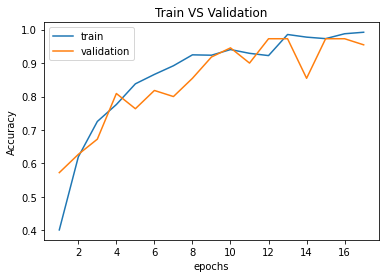

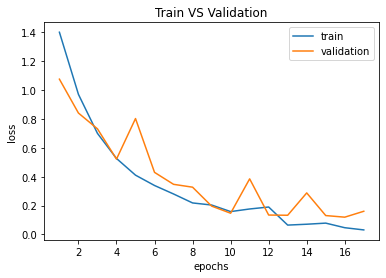

In [ ]:
a111,l111,a112,l112 = plot_performance(tracker=history11,epochs=17)

In [ ]:
# tr_acc,tr_loss,val_acc,val_loss
print("the train accuracy of the model : ",a111)
print(" the train loss of the model : ",l111)
print("="*50)
print(" the test sccuracy of the model : ",a112)
print("the loss of the model :",l112)

the train accuracy of the model :  [0.4015747904777527, 0.6197975277900696, 0.7255343198776245, 0.7761529684066772, 0.8380202651023865, 0.8661417365074158, 0.8920134902000427, 0.9246343970298767, 0.9235095381736755, 0.9403824806213379, 0.9291338324546814, 0.9223846793174744, 0.9853768348693848, 0.9775028228759766, 0.9730033874511719, 0.9876265525817871, 0.9921259880065918]
 the train loss of the model :  [1.401766300201416, 0.970910370349884, 0.7002120614051819, 0.5263376235961914, 0.4105570316314697, 0.3387770354747772, 0.2799946069717407, 0.21782566606998444, 0.20341190695762634, 0.15784715116024017, 0.17592501640319824, 0.18957611918449402, 0.0642019733786583, 0.07019127905368805, 0.07783067971467972, 0.046026844531297684, 0.030729178339242935]
 the test sccuracy of the model :  [0.5727272629737854, 0.6272727251052856, 0.6727272868156433, 0.8090909123420715, 0.7636363506317139, 0.8181818127632141, 0.800000011920929, 0.8545454740524292, 0.918181836605072, 0.9454545378684998, 0.899999

In [ ]:
# save the best model 
filepath1 =  "./best_{}_model.h5".format("VGG-19")
best_vggmodel_19  = keras.models.load_model(filepath1)
# dump the classification model.
pickle.dump(best_vggmodel_19, open('best_vgg19.pkl', 'wb'))


INFO:tensorflow:Assets written to: ram://ad990249-ac1a-42d6-bc29-ff7dcc24961c/assets


accuracy of the model :  0.9727272727272728


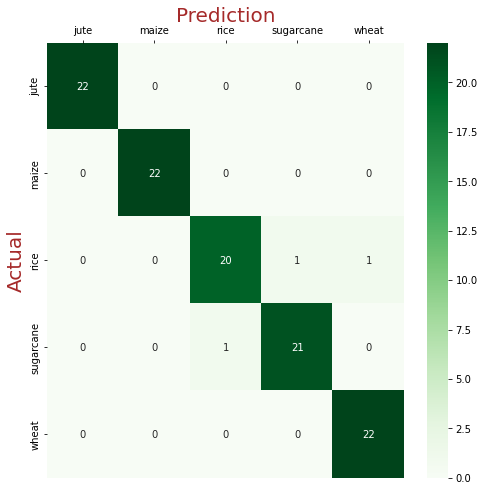

In [ ]:
import pickle
from sklearn.metrics import confusion_matrix,accuracy_score
import tensorflow as tf
from keras.models import load_model

#load the best_model

best_model1 = pickle.load(open('best_vgg19.pkl', 'rb'))

#best_model1.fit(dx_train,y_train1) # fittting the model.
#best_model1 = load_model("/content/vgg19.h5")
y_predict = best_model1.predict(dx_test) # predicting the labels.

true_label = np.argmax(y_test1,axis=1) # use y_test
predict_label = np.argmax(y_predict,axis=1)

# plot the confusion matrix :

plt.figure(figsize=(8,8))
class_label = ["jute","maize","rice","sugarcane","wheat"]
fig = sns.heatmap(confusion_matrix(true_label,predict_label),annot=True,cmap="Greens",xticklabels=class_label,yticklabels=class_label)

fig.set_xlabel("Prediction",fontsize=20,color="brown")
fig.xaxis.set_label_position('top')
fig.xaxis.tick_top() # able to set top , bottom , for y axis able to set right/left.
fig.set_ylabel("Actual",fontsize=20,color="brown")

acc1 = accuracy_score(true_label,predict_label)
print("accuracy of the model : ",acc1)

In [ ]:
# here only one image can be predicted as the rice but actually that image is sugarcane.
# wrongly predicted the rice as sugarcane, wheat.
# jute predicted properly
# maize also predicted properly.

In [ ]:
df.head(3)

,path,crop,croplabel
0,/kaggle/input/kag2/sugarcane/sugarcane037ahs.jpeg,sugarcane,3
1,/kaggle/input/kag2/sugarcane/sugarcane034a.jpeg,sugarcane,3
2,/kaggle/input/kag2/sugarcane/sugarcane032arot....,sugarcane,3


In [ ]:
df["path"][0]

'/kaggle/input/kag2/sugarcane/sugarcane037ahs.jpeg'

In [ ]:
ip = '/kaggle/input/agriculture-crop-images/kag2/rice/rice024ahs.jpeg'
ip = "/kaggle/input/kag2/sugarcane/sugarcane037ahs.jpeg"

100%|██████████| 1/1 [00:00<00:00, 95.04it/s]


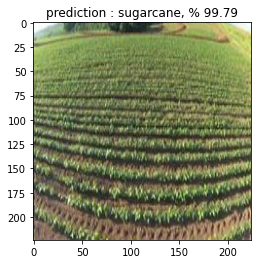

In [ ]:
data_pipeline(ip,model=best_model1)

###4.2 cnn model

In [ ]:
# baseline model with dropout on the planet dataset
import sys
from numpy import load
from matplotlib import pyplot
from sklearn.model_selection import train_test_split
from keras import backend
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
from keras.layers import Conv2D
from keras.layers import MaxPooling2D
from keras.layers import Dense
from keras.layers import Flatten
from keras.layers import Dropout


In [ ]:
import tensorflow as tf
tf.keras.backend.clear_session()
#from tf.keras.optimizers import SGD
from tensorflow import keras
from tensorflow.keras import layers

In [ ]:
## define cnn model
def define_model(in_shape=(128, 128, 3), out_shape=17):
  model = Sequential()
  model.add(Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same', input_shape=in_shape))
  model.add(Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
  model.add(MaxPooling2D((2, 2)))
  model.add(Dropout(0.2))
  model.add(Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
  model.add(Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
  model.add(MaxPooling2D((2, 2)))
  model.add(Dropout(0.2))
  model.add(Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
  model.add(Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
  model.add(MaxPooling2D((2, 2)))
  model.add(Dropout(0.2))
  model.add(Flatten())
  model.add(Dense(128, activation='relu', kernel_initializer='he_uniform'))
  model.add(Dropout(0.5))
  model.add(Dense(out_shape, activation='softmax'))
  model.compile(optimizer = 'adam',loss = 'categorical_crossentropy',metrics=['accuracy']) 
  # compile model
  #model.compile(optimizer = 'adam',loss = 'categorical_crossentropy',metrics=['accuracy'])
  return model

In [ ]:
cnn_model2 = define_model(in_shape=(224,224,3),out_shape=5)
cnn_model2.summary()
#plot_model(cnn_model2, to_file='custom_cnn_model2.png', show_shapes=True, show_layer_names=True)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 224, 224, 32)      896       
                                                                 
 conv2d_1 (Conv2D)           (None, 224, 224, 32)      9248      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 32)     0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 112, 112, 32)      0         
                                                                 
 conv2d_2 (Conv2D)           (None, 112, 112, 64)      18496     
                                                                 
 conv2d_3 (Conv2D)           (None, 112, 112, 64)      36928     
                                                        

In [ ]:
history12 = cnn_model2.fit(dx_train,y_train1,epochs=20,validation_data = (dx_test,y_test1),callbacks=required_callbacks(model_name="custom_cnn"),batch_size=12)

Epoch 1/20
75/75 [==============================] - ETA: 0s - loss: 1.6049 - accuracy: 0.2115
Epoch 1: val_accuracy improved from -inf to 0.23636, saving model to ./best_custom_cnn_model.h5
75/75 [==============================] - 13s 151ms/step - loss: 1.6049 - accuracy: 0.2115 - val_loss: 1.5934 - val_accuracy: 0.2364 - lr: 8.1000e-04
Epoch 2/20
74/75 [============================>.] - ETA: 0s - loss: 1.5836 - accuracy: 0.2635
Epoch 2: val_accuracy improved from 0.23636 to 0.30000, saving model to ./best_custom_cnn_model.h5
75/75 [==============================] - 10s 138ms/step - loss: 1.5829 - accuracy: 0.2632 - val_loss: 1.5575 - val_accuracy: 0.3000 - lr: 8.1000e-04
Epoch 3/20
74/75 [============================>.] - ETA: 0s - loss: 1.5954 - accuracy: 0.2545
Epoch 3: val_accuracy did not improve from 0.30000
75/75 [==============================] - 9s 123ms/step - loss: 1.5952 - accuracy: 0.2542 - val_loss: 1.5596 - val_accuracy: 0.3000 - lr: 8.1000e-04
Epoch 4/20
74/75 [========

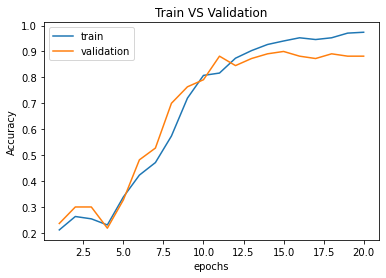

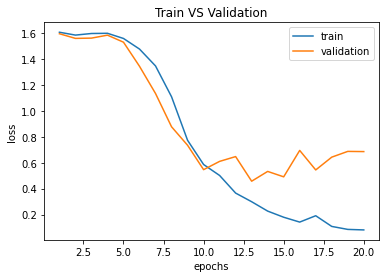

In [ ]:
a121,l121,a122,l122 = plot_performance(tracker=history12,epochs=20)

In [ ]:
# tr_acc,tr_loss,val_acc,val_loss
print("the train accuracy of the model : ",a121)
print(" the train loss of the model : ",l121)
print("="*50)
print(" the test sccuracy of the model : ",a122)
print("the loss of the model :",l122)

the train accuracy of the model :  [0.21147356927394867, 0.26321709156036377, 0.2542182207107544, 0.2305961698293686, 0.3385826647281647, 0.42294713854789734, 0.4713160991668701, 0.5736783146858215, 0.7199100255966187, 0.8076490163803101, 0.8166479468345642, 0.874015748500824, 0.9032620787620544, 0.926884114742279, 0.9403824806213379, 0.9527559280395508, 0.9460067749023438, 0.9527559280395508, 0.9707536697387695, 0.974128246307373]
 the train loss of the model :  [1.6048917770385742, 1.582930088043213, 1.5951921939849854, 1.596826195716858, 1.556908369064331, 1.4751895666122437, 1.3451354503631592, 1.1077203750610352, 0.77239990234375, 0.5858418345451355, 0.5012995004653931, 0.36561569571495056, 0.2990330159664154, 0.22681891918182373, 0.17956103384494781, 0.14218805730342865, 0.19109812378883362, 0.1087702065706253, 0.08582417666912079, 0.08185287564992905]
 the test sccuracy of the model :  [0.23636363446712494, 0.30000001192092896, 0.30000001192092896, 0.2181818187236786, 0.32727271

In [ ]:
# save the best model 
fp =  "./best_{}_model.h5".format("custom_cnn")
best_cnn_model  = keras.models.load_model(fp)

import pickle
# dump the classification model.
pickle.dump(best_cnn_model, open('best_customcnn_model.pkl', 'wb'))


INFO:tensorflow:Assets written to: ram://d0f8fe84-683f-4148-946a-7d3d3b56739e/assets


accuracy of the model :  0.9


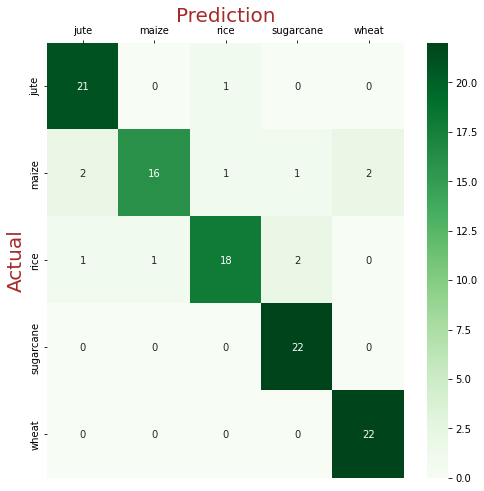

In [ ]:
import pickle
from sklearn.metrics import confusion_matrix,accuracy_score
import tensorflow as tf
from keras.models import load_model

#load the best_model

best_model2 = pickle.load(open('best_customcnn_model.pkl', 'rb'))

y_predict = best_model2.predict(dx_test) # predicting the labels.

true_label = np.argmax(y_test1,axis=1) # use y_test
predict_label = np.argmax(y_predict,axis=1)

# plot the confusion matrix :

plt.figure(figsize=(8,8))
class_label = ["jute","maize","rice","sugarcane","wheat"]
fig = sns.heatmap(confusion_matrix(true_label,predict_label),annot=True,cmap="Greens",xticklabels=class_label,yticklabels=class_label)

fig.set_xlabel("Prediction",fontsize=20,color="brown")
fig.xaxis.set_label_position('top')
fig.xaxis.tick_top() # able to set top , bottom , for y axis able to set right/left.
fig.set_ylabel("Actual",fontsize=20,color="brown")

acc2 = accuracy_score(true_label,predict_label)
print("accuracy of the model : ",acc2)

In [ ]:
# this is the custom cnn model for my own interest .
# it gives some wrong predictions 
# 11 images are predicted wrongly among 100 images.

100%|██████████| 1/1 [00:00<00:00, 243.74it/s]


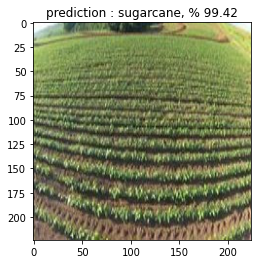

In [ ]:
ip = '/kaggle/input/agriculture-crop-images/kag2/rice/rice024ahs.jpeg'
ip = "/kaggle/input/kag2/sugarcane/sugarcane037ahs.jpeg"
data_pipeline(ip,model=best_model2)

### 4.3vgg16

In [ ]:
# refer for the base model set up : https://www.analyticsvidhya.com/blog/2020/08/top-4-pre-trained-models-for-image-classification-with-python-code/
# for the optimizers : https://keras.io/api/optimizers/

In [ ]:
from tensorflow.keras.applications.vgg16 import VGG16

base_model_vg16 = VGG16(input_shape = (224, 224, 3), # Shape of our images
                    include_top = False, # Leave out the last fully connected layer
                    weights = 'imagenet')
base_model_vg16.trainable = False

# Flatten the output layer to 1 dimension
x = layers.Flatten()(base_model_vg16.output)

# Add a fully connected layer with 512 hidden units and ReLU activation
x = layers.Dense(256, activation='relu')(x) # 1024 ,512

# Add a dropout rate of 0.5
x = layers.Dropout(0.5)(x)

# Add a final sigmoid layer with 1 node for classification output
x = layers.Dense(5, activation='softmax')(x)

vgg_model_16 = tf.keras.models.Model(base_model_vg16.input, x)

#model1.compile(optimizer = tf.keras.optimizers.RMSprop(lr=0.0001), loss = 'binary_crossentropy',metrics = ['acc'])
vgg_model_16.compile(optimizer = 'adam',loss = 'categorical_crossentropy',metrics=['accuracy'])
vgg_model_16.summary()
#plot_model(vgg_model_16, to_file='vgg_16_model3.png', show_shapes=True, show_layer_names=True)

58900480/58889256 [==============================] - 1s 0us/step
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                              

In [ ]:
history13 = vgg_model_16.fit(dx_train,y_train1,epochs=50,validation_data=(dx_test,y_test1),callbacks = required_callbacks(model_name="VGG-16"),batch_size=12)

In [ ]:
#vgghist = model1.fit(train_generator, validation_data = validation_generator, steps_per_epoch = 100, epochs = 10)
#history13 = vgg_model_16.fit(dx_train,y_train1,epochs=10,validation_split=0.2,batch_size=12)
history13 = vgg_model_16.fit(dx_train,y_train1,epochs=20,validation_data=(dx_test,y_test1),callbacks = required_callbacks(model_name="VGG-16"),batch_size=12)

Epoch 1/20
74/75 [============================>.] - ETA: 0s - loss: 2.0126 - accuracy: 0.3896
Epoch 1: val_accuracy improved from -inf to 0.72727, saving model to ./best_VGG-16_model.h5
75/75 [==============================] - 16s 179ms/step - loss: 2.0117 - accuracy: 0.3903 - val_loss: 0.8433 - val_accuracy: 0.7273 - lr: 0.0010
Epoch 2/20
74/75 [============================>.] - ETA: 0s - loss: 0.8315 - accuracy: 0.6712
Epoch 2: val_accuracy improved from 0.72727 to 0.89091, saving model to ./best_VGG-16_model.h5
75/75 [==============================] - 13s 168ms/step - loss: 0.8306 - accuracy: 0.6715 - val_loss: 0.4698 - val_accuracy: 0.8909 - lr: 0.0010
Epoch 3/20
74/75 [============================>.] - ETA: 0s - loss: 0.5250 - accuracy: 0.8007
Epoch 3: val_accuracy did not improve from 0.89091
75/75 [==============================] - 12s 163ms/step - loss: 0.5247 - accuracy: 0.8009 - val_loss: 0.3844 - val_accuracy: 0.8727 - lr: 0.0010
Epoch 4/20
74/75 [===========================

In [ ]:
print(history13)

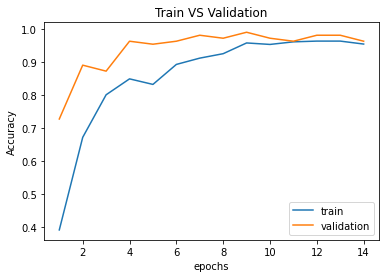

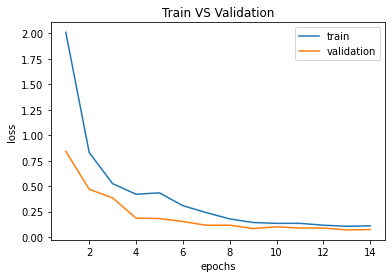

In [ ]:
a131,l131,a132,l132 = plot_performance(tracker=history13,epochs=14)

In [ ]:
# tr_acc,tr_loss,val_acc,val_loss
print("the train accuracy of the model : ",a131)
print(" the train loss of the model : ",l131)
print("="*50)
print(" the test sccuracy of the model : ",a132)
print("the loss of the model :",l132)

the train accuracy of the model :  [0.39032620191574097, 0.6715410351753235, 0.800899863243103, 0.8492688536643982, 0.8323959708213806, 0.8931383490562439, 0.9122609496116638, 0.9257592558860779, 0.9583802223205566, 0.953880786895752, 0.9617547988891602, 0.9640045166015625, 0.9640045166015625, 0.9550056457519531]
 the train loss of the model :  [2.011701822280884, 0.8305676579475403, 0.524653971195221, 0.4206712245941162, 0.43439266085624695, 0.30848363041877747, 0.24043402075767517, 0.1783083975315094, 0.14305655658245087, 0.1346021592617035, 0.1347992718219757, 0.11654546856880188, 0.10628262907266617, 0.11014539003372192]
 the test sccuracy of the model :  [0.7272727489471436, 0.8909090757369995, 0.8727272748947144, 0.9636363387107849, 0.9545454382896423, 0.9636363387107849, 0.9818181991577148, 0.9727272987365723, 0.9909090995788574, 0.9727272987365723, 0.9636363387107849, 0.9818181991577148, 0.9818181991577148, 0.9636363387107849]
the loss of the model : [0.8433086276054382, 0.4697

In [ ]:
# save the best model 
fp =  "./best_{}_model.h5".format("VGG-16")
best_VGG16_model  = keras.models.load_model(fp)

import pickle
# dump the classification model.
pickle.dump(best_VGG16_model, open('best_VGG16_model.pkl', 'wb'))
best_model3 = pickle.load(open('best_VGG16_model.pkl', 'rb'))

INFO:tensorflow:Assets written to: ram://53662500-869a-4e33-9b5d-be8cb45045d4/assets


accuracy of the model :  0.990909090909091


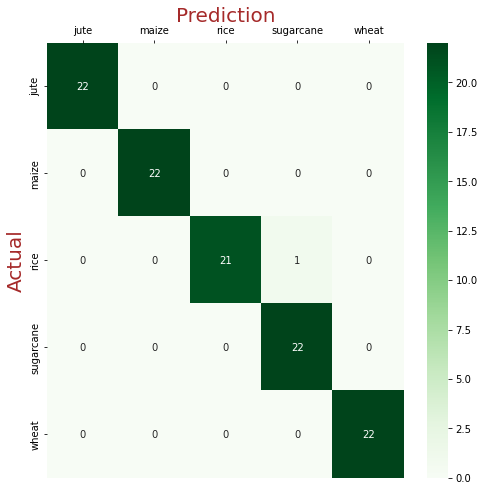

In [ ]:
import pickle
from sklearn.metrics import confusion_matrix,accuracy_score
import tensorflow as tf
from keras.models import load_model

#load the best_model

best_model3 = pickle.load(open('best_VGG16_model.pkl', 'rb'))
y_predict = best_model3.predict(dx_test) # predicting the labels.

true_label = np.argmax(y_test1,axis=1) # use y_test
predict_label = np.argmax(y_predict,axis=1)

# plot the confusion matrix :

plt.figure(figsize=(8,8))
class_label = ["jute","maize","rice","sugarcane","wheat"]
fig = sns.heatmap(confusion_matrix(true_label,predict_label),annot=True,cmap="Greens",xticklabels=class_label,yticklabels=class_label)

fig.set_xlabel("Prediction",fontsize=20,color="brown")
fig.xaxis.set_label_position('top')
fig.xaxis.tick_top() # able to set top , bottom , for y axis able to set right/left.
fig.set_ylabel("Actual",fontsize=20,color="brown")

acc3 = accuracy_score(true_label,predict_label)
print("accuracy of the model : ",acc3)

In [ ]:
# VGG-16 model works very well
# it predicts only one image as wrong.

100%|██████████| 1/1 [00:00<00:00, 236.69it/s]


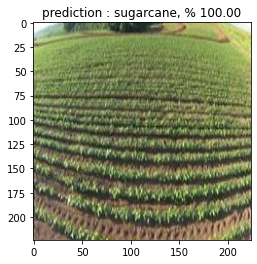

In [ ]:
ip = '/kaggle/input/agriculture-crop-images/kag2/rice/rice024ahs.jpeg'
ip = "/kaggle/input/kag2/sugarcane/sugarcane037ahs.jpeg"
data_pipeline(ip,model=best_model3)

###4.4 inception

In [ ]:
## inception:
from tensorflow.keras.applications.inception_v3 import InceptionV3
base_inception_model = InceptionV3(input_shape = (224, 224, 3), include_top = False, weights = 'imagenet')
# we will change only  the last layer.
for layer in base_inception_model.layers:
    layer.trainable = False
base_inception_model.trainable = False

from tensorflow.keras.optimizers import RMSprop

x = layers.Flatten()(base_inception_model.output)
x = layers.Dense(256, activation='relu')(x) # 512,256
x = layers.Dropout(0.3)(x) # 0.2

# Add a final softmax layer with 1 node for multi classification output
x = layers.Dense(5, activation='softmax')(x)

inception_model = tf.keras.models.Model(base_inception_model.input, x)

inception_model.compile(optimizer = RMSprop(learning_rate=0.0001), loss = 'categorical_crossentropy', metrics = ['accuracy'])
inception_model.summary()
#plot_model(inception_model, to_file='inception_model4.png', show_shapes=True, show_layer_names=True)

87924736/87910968 [==============================] - 1s 0us/step
Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_6 (Conv2D)              (None, 111, 111, 32  864         ['input_2[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 111, 111, 32  96         ['conv2d_6[0][0]']               
 alization)                

In [ ]:
#inc_history = model.fit_generator(train_generator, validation_data = validation_generator, steps_per_epoch = 100, epochs = 10)
#history13 = model2.fit(dx_train,y_train1,epochs=10,validation_split=0.2,batch_size=1)
history14 = inception_model.fit(dx_train,y_train1,epochs=20,validation_data=(dx_test,y_test1),callbacks = required_callbacks(model_name="INCEPTION"),batch_size=12)


Epoch 1/20
75/75 [==============================] - ETA: 0s - loss: 1.8166 - accuracy: 0.5996
Epoch 1: val_accuracy improved from -inf to 0.87273, saving model to ./best_INCEPTION_model.h5
75/75 [==============================] - 20s 159ms/step - loss: 1.8166 - accuracy: 0.5996 - val_loss: 0.3605 - val_accuracy: 0.8727 - lr: 1.0000e-04
Epoch 2/20
74/75 [============================>.] - ETA: 0s - loss: 0.3228 - accuracy: 0.8998
Epoch 2: val_accuracy improved from 0.87273 to 0.92727, saving model to ./best_INCEPTION_model.h5
75/75 [==============================] - 9s 115ms/step - loss: 0.3224 - accuracy: 0.8999 - val_loss: 0.2889 - val_accuracy: 0.9273 - lr: 1.0000e-04
Epoch 3/20
74/75 [============================>.] - ETA: 0s - loss: 0.1421 - accuracy: 0.9448
Epoch 3: val_accuracy did not improve from 0.92727
75/75 [==============================] - 8s 101ms/step - loss: 0.1419 - accuracy: 0.9449 - val_loss: 0.7849 - val_accuracy: 0.8273 - lr: 1.0000e-04
Epoch 4/20
74/75 [===========

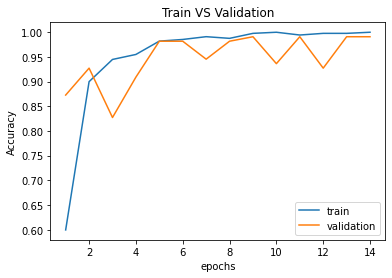

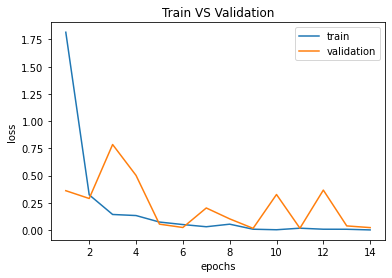

In [ ]:

a141,l141,a142,l142=plot_performance(tracker=history14,epochs=14)

In [ ]:
# tr_acc,tr_loss,val_acc,val_loss
print("the train accuracy of the model : ",a141)
print(" the train loss of the model : ",l141)
print("="*50)
print(" the test sccuracy of the model : ",a142)
print("the loss of the model :",l142)

the train accuracy of the model :  [0.5995500683784485, 0.8998875021934509, 0.9448819160461426, 0.9550056457519531, 0.9820022583007812, 0.9853768348693848, 0.9910011291503906, 0.9876265525817871, 0.9977502822875977, 1.0, 0.9943757057189941, 0.9977502822875977, 0.9977502822875977, 1.0]
 the train loss of the model :  [1.816642165184021, 0.3224346339702606, 0.14194785058498383, 0.1321609765291214, 0.07242318987846375, 0.04940711334347725, 0.02923189289867878, 0.05275346711277962, 0.0065276138484478, 0.0015996405854821205, 0.015883978456258774, 0.006399152334779501, 0.00608240207657218, 6.276283966144547e-05]
 the test sccuracy of the model :  [0.8727272748947144, 0.9272727370262146, 0.8272727131843567, 0.9090909361839294, 0.9818181991577148, 0.9818181991577148, 0.9454545378684998, 0.9818181991577148, 0.9909090995788574, 0.9363636374473572, 0.9909090995788574, 0.9272727370262146, 0.9909090995788574, 0.9909090995788574]
the loss of the model : [0.36046987771987915, 0.2888554632663727, 0.78

In [ ]:
# save the best model 
fp =  "./best_{}_model.h5".format("INCEPTION")
best_inception_model  = keras.models.load_model(fp)

import pickle
# dump the classification model.
pickle.dump(best_inception_model, open('best_INCEPTION_model.pkl', 'wb'))
best_model4 = pickle.load(open('best_INCEPTION_model.pkl', 'rb'))

INFO:tensorflow:Assets written to: ram://590b7f60-6e26-4e87-8c15-1939c0787d63/assets


accuracy of the model :  0.990909090909091


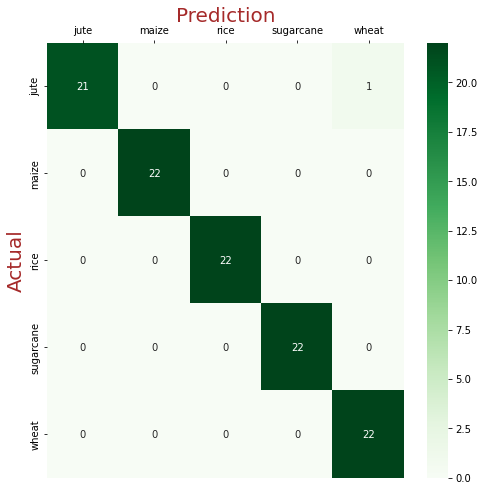

In [ ]:
import pickle
from sklearn.metrics import confusion_matrix,accuracy_score
import tensorflow as tf
from keras.models import load_model

#load the best_model

best_model4 = pickle.load(open('best_INCEPTION_model.pkl', 'rb'))

y_predict = best_model4.predict(dx_test) # predicting the labels.

true_label = np.argmax(y_test1,axis=1) # use y_test
predict_label = np.argmax(y_predict,axis=1)

# plot the confusion matrix :

plt.figure(figsize=(8,8))
class_label = ["jute","maize","rice","sugarcane","wheat"]
fig = sns.heatmap(confusion_matrix(true_label,predict_label),annot=True,cmap="Greens",xticklabels=class_label,yticklabels=class_label)

fig.set_xlabel("Prediction",fontsize=20,color="brown")
fig.xaxis.set_label_position('top')
fig.xaxis.tick_top() # able to set top , bottom , for y axis able to set right/left.
fig.set_ylabel("Actual",fontsize=20,color="brown")

acc4 = accuracy_score(true_label,predict_label)
print("accuracy of the model : ",acc4)

100%|██████████| 1/1 [00:00<00:00, 349.38it/s]


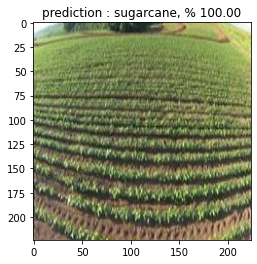

In [ ]:
ip = '/kaggle/input/agriculture-crop-images/kag2/rice/rice024ahs.jpeg'
ip = "/kaggle/input/kag2/sugarcane/sugarcane037ahs.jpeg"
data_pipeline(ip,model=best_model4)

### 4.5 resnet model

In [ ]:
# resnet:

from tensorflow.keras.applications import ResNet50
from tensorflow.python.keras.models import Sequential
from tensorflow.python.keras.layers import Dense, Flatten, GlobalAveragePooling2D


base_resnet_model = ResNet50(input_shape=(224, 224,3), include_top=False, weights="imagenet")
# only modify the last layer
for layer in base_resnet_model.layers:
    layer.trainable = False

base_resnet_model.trainable=False

x = layers.Flatten()(base_resnet_model.output)
x = layers.Dense(1024, activation='relu')(x) # 512,256
x = layers.Dropout(0.5)(x) # 0.2

# Add a final softmax layer with 1 node for multi classification output
x = layers.Dense(5, activation='softmax')(x)

resnet_model = tf.keras.models.Model(base_resnet_model.input, x)
resnet_model.compile(optimizer = RMSprop(learning_rate=0.0001), loss = 'categorical_crossentropy', metrics = ['accuracy'])
resnet_model.summary()
#plot_model(resnet_model, to_file='resnetmodel5.png', show_shapes=True, show_layer_names=True)
#base_model3 = Sequential()
#base_model3.add(ResNet50(include_top=False, weights='imagenet', pooling='max'))
#base_model3.add(Dense(5, activation='softmax'))


94781440/94765736 [==============================] - 1s 0us/step
Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_3[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                           

In [ ]:
#inc_history = model.fit_generator(train_generator, validation_data = validation_generator, steps_per_epoch = 100, epochs = 10)
#history14 = resnet_model.fit(dx_train,y_train1,epochs=10,validation_split=0.2,batch_size=1)
history15 = resnet_model.fit(dx_train,y_train1,epochs=40,validation_data=(dx_test,y_test1),callbacks = required_callbacks(model_name="RESNET"),batch_size=12)


Epoch 1/40
75/75 [==============================] - ETA: 0s - loss: 3.3674 - accuracy: 0.2418
Epoch 1: val_accuracy improved from -inf to 0.20000, saving model to ./best_RESNET_model.h5
75/75 [==============================] - 26s 266ms/step - loss: 3.3674 - accuracy: 0.2418 - val_loss: 5.6384 - val_accuracy: 0.2000 - lr: 1.0000e-04
Epoch 2/40
75/75 [==============================] - ETA: 0s - loss: 2.1106 - accuracy: 0.2677
Epoch 2: val_accuracy did not improve from 0.20000
75/75 [==============================] - 13s 173ms/step - loss: 2.1106 - accuracy: 0.2677 - val_loss: 4.3587 - val_accuracy: 0.2000 - lr: 1.0000e-04
Epoch 3/40
75/75 [==============================] - ETA: 0s - loss: 1.7050 - accuracy: 0.3183
Epoch 3: val_accuracy did not improve from 0.20000

Epoch 3: ReduceLROnPlateau reducing learning rate to 8.999999772640876e-05.
75/75 [==============================] - 13s 172ms/step - loss: 1.7050 - accuracy: 0.3183 - val_loss: 2.9211 - val_accuracy: 0.2000 - lr: 1.0000e-04


In [ ]:
# 128 not give

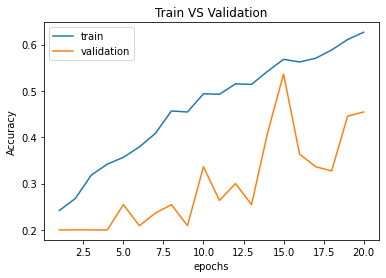

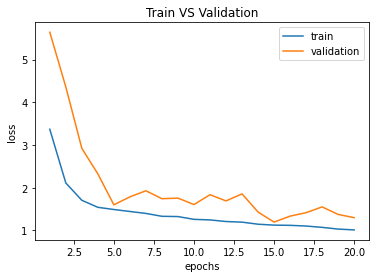

In [ ]:
a151,l151,a152,l152 = plot_performance(tracker=history15,epochs=20)

In [ ]:
# tr_acc,tr_loss,val_acc,val_loss
print("the train accuracy of the model : ",a151)
print(" the train loss of the model : ",l151)
print("="*50)
print(" the test sccuracy of the model : ",a152)
print("the loss of the model :",l152)

the train accuracy of the model :  [0.2418447732925415, 0.26771652698516846, 0.3183352053165436, 0.3419572412967682, 0.3565804362297058, 0.37907761335372925, 0.4083239734172821, 0.4566929042339325, 0.45444318652153015, 0.49381327629089355, 0.4926884174346924, 0.5151855945587158, 0.5140607357025146, 0.542182207107544, 0.5680540204048157, 0.562429666519165, 0.570303738117218, 0.5883014798164368, 0.6107986569404602, 0.6265466809272766]
 the train loss of the model :  [3.367389678955078, 2.1106317043304443, 1.7049710750579834, 1.540617823600769, 1.4893299341201782, 1.4430420398712158, 1.3973467350006104, 1.3303922414779663, 1.3241280317306519, 1.2586992979049683, 1.2457411289215088, 1.2081795930862427, 1.1934654712677002, 1.1450629234313965, 1.123664140701294, 1.1187872886657715, 1.1024212837219238, 1.071296215057373, 1.0311826467514038, 1.0115910768508911]
 the test sccuracy of the model :  [0.20000000298023224, 0.20000000298023224, 0.20000000298023224, 0.20000000298023224, 0.254545450210

In [ ]:
# save the best model 
fp =  "./best_{}_model.h5".format("RESNET")
best_resnet_model  = keras.models.load_model(fp)

import pickle
# dump the classification model.
pickle.dump(best_resnet_model, open('best_RESNET_model.pkl', 'wb'))
best_model5 = pickle.load(open('best_RESNET_model.pkl', 'rb'))

INFO:tensorflow:Assets written to: ram://b2c44b90-012b-42d6-a594-034d6d09d59c/assets


In [ ]:
best_model5 = pickle.load(open('best_RESNET_model.pkl', 'rb'))

accuracy of the model :  0.5363636363636364


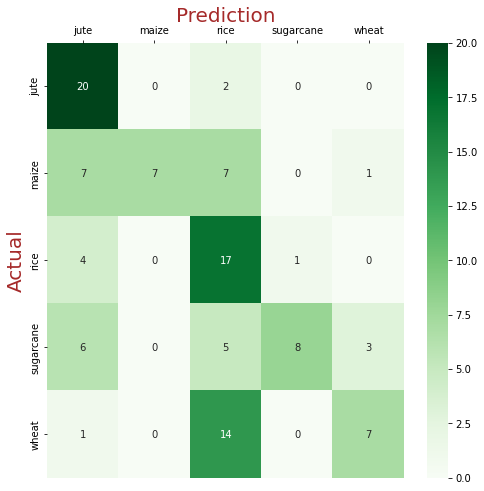

In [ ]:
import pickle
from sklearn.metrics import confusion_matrix,accuracy_score
import tensorflow as tf
from keras.models import load_model

#load the best_model

best_model5 = pickle.load(open('best_RESNET_model.pkl', 'rb'))

y_predict = best_model5.predict(dx_test) # predicting the labels.

true_label = np.argmax(y_test1,axis=1) # use y_test
predict_label = np.argmax(y_predict,axis=1)

# plot the confusion matrix :

plt.figure(figsize=(8,8))
class_label = ["jute","maize","rice","sugarcane","wheat"]
fig = sns.heatmap(confusion_matrix(true_label,predict_label),annot=True,cmap="Greens",xticklabels=class_label,yticklabels=class_label)

fig.set_xlabel("Prediction",fontsize=20,color="brown")
fig.xaxis.set_label_position('top')
fig.xaxis.tick_top() # able to set top , bottom , for y axis able to set right/left.
fig.set_ylabel("Actual",fontsize=20,color="brown")

acc5 = accuracy_score(true_label,predict_label)
print("accuracy of the model : ",acc5)

In [ ]:
# resnet model not gives the good result 
# it classsifies the wheat as rice mostly 
# training accuracy is also not well.

100%|██████████| 1/1 [00:00<00:00, 61.97it/s]


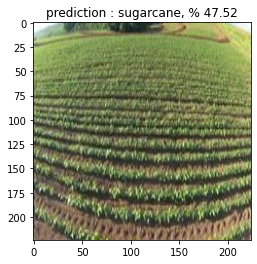

In [ ]:
ip = '/kaggle/input/agriculture-crop-images/kag2/rice/rice024ahs.jpeg'
ip = "/kaggle/input/kag2/sugarcane/sugarcane037ahs.jpeg"
data_pipeline(ip,model=best_model5)

###4.6 efficient model

In [ ]:
from tensorflow.keras.applications import EfficientNetB0

In [ ]:
!pip install -U efficientnet

In [ ]:
#import efficientnet.keras as efn
from tensorflow.keras.applications import EfficientNetB0

base_efficient_model = EfficientNetB0(input_shape = (224, 224, 3), include_top = False, weights = 'imagenet')
for layer in base_efficient_model.layers:
    layer.trainable = False

base_efficient_model.trainable=False

#x = base_model5.output
x = layers.Flatten()(base_efficient_model.output)
x = layers.Dense(128, activation='relu')(x) # 512,256
x = layers.Dropout(0.5)(x) # 0.2
x = layers.Dense(5, activation='softmax')(x)
efficient_model = tf.keras.models.Model(base_efficient_model.input, x)

#x = Flatten()(x)
#x = Dense(128, activation="relu")(x) # 1024 ,512
#x = Dropout(0.5)(x)

# Add a final sigmoid layer with 1 node for classification output
#predictions = Dense(5, activation="softmax")(x)
#model5 = Model(input = base_model5.input, output = predictions)

efficient_model.compile(optimizer = RMSprop(learning_rate=0.0001), loss = 'categorical_crossentropy', metrics = ['accuracy'])
efficient_model.summary()
#plot_model(efficient_model, to_file='effectivenet_model6.png', show_shapes=True, show_layer_names=True)

Model: "model_9"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_10 (InputLayer)          [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling_6 (Rescaling)        (None, 224, 224, 3)  0           ['input_10[0][0]']               
                                                                                                  
 normalization_6 (Normalization  (None, 224, 224, 3)  7          ['rescaling_6[0][0]']            
 )                                                                                                
                                                                                            

In [ ]:
history16 = efficient_model.fit(dx_train,y_train1,epochs=50,validation_data=(dx_test,y_test1),callbacks = required_callbacks(model_name="EFFICIENTNET"),batch_size=16)

Epoch 1/50
56/56 [==============================] - ETA: 0s - loss: 2.2201 - accuracy: 0.1867
Epoch 1: val_accuracy improved from -inf to 0.20000, saving model to ./best_EFFICIENTNET_model.h5
56/56 [==============================] - 17s 165ms/step - loss: 2.2201 - accuracy: 0.1867 - val_loss: 1.6094 - val_accuracy: 0.2000 - lr: 1.0000e-04
Epoch 2/50
56/56 [==============================] - ETA: 0s - loss: 1.6166 - accuracy: 0.1890
Epoch 2: val_accuracy did not improve from 0.20000
56/56 [==============================] - 5s 86ms/step - loss: 1.6166 - accuracy: 0.1890 - val_loss: 1.6094 - val_accuracy: 0.2000 - lr: 1.0000e-04
Epoch 3/50
56/56 [==============================] - ETA: 0s - loss: 1.6143 - accuracy: 0.1755
Epoch 3: val_accuracy did not improve from 0.20000

Epoch 3: ReduceLROnPlateau reducing learning rate to 8.999999772640876e-05.
56/56 [==============================] - 5s 86ms/step - loss: 1.6143 - accuracy: 0.1755 - val_loss: 1.6094 - val_accuracy: 0.2000 - lr: 1.0000e-0

In [ ]:
# there ids no change in accuracy.

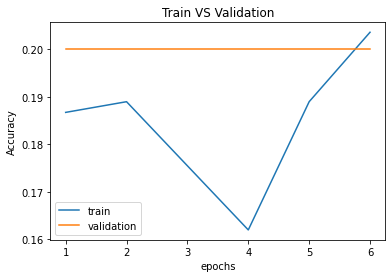

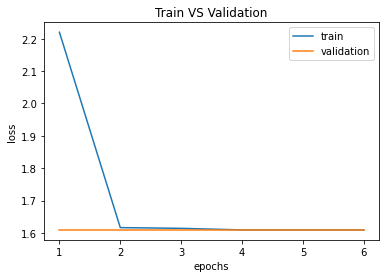

In [ ]:
a161,l161,a162,l162 = plot_performance(tracker=history16,epochs=6)

In [ ]:
# tr_acc,tr_loss,val_acc,val_loss
print("the train accuracy of the model : ",a161)
print(" the train loss of the model : ",l161)
print("="*50)
print(" the test sccuracy of the model : ",a162)
print("the loss of the model :",l162)

the train accuracy of the model :  [0.1867266595363617, 0.18897637724876404, 0.17547807097434998, 0.16197974979877472, 0.18897637724876404, 0.20359955728054047]
 the train loss of the model :  [2.2200934886932373, 1.616558313369751, 1.6142847537994385, 1.6094712018966675, 1.6094518899917603, 1.6094533205032349]
 the test sccuracy of the model :  [0.20000000298023224, 0.20000000298023224, 0.20000000298023224, 0.20000000298023224, 0.20000000298023224, 0.20000000298023224]
the loss of the model : [1.6094378232955933, 1.6094379425048828, 1.6094378232955933, 1.6094379425048828, 1.6094380617141724, 1.6094379425048828]


In [ ]:
# save the best model 
fp =  "./best_{}_model.h5".format("EFFICIENTNET")
best_efficient_model  = keras.models.load_model(fp)

import pickle
# dump the classification model.
pickle.dump(best_efficient_model, open('best_EFFICIENTNET_model.pkl', 'wb'))
best_model6 = pickle.load(open('best_EFFICIENTNET_model.pkl', 'rb'))

INFO:tensorflow:Assets written to: ram://7c7bdcf9-3fa7-4c6f-a77f-09b25085f2fc/assets


accuracy of the model :  0.2


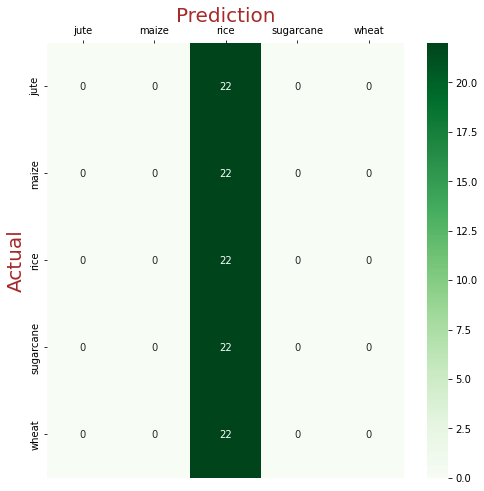

In [ ]:
import pickle
from sklearn.metrics import confusion_matrix,accuracy_score
import tensorflow as tf
from keras.models import load_model

#load the best_model

best_model6 = pickle.load(open('best_EFFICIENTNET_model.pkl', 'rb'))
y_predict = best_model6.predict(dx_test) # predicting the labels.

true_label = np.argmax(y_test1,axis=1) # use y_test
predict_label = np.argmax(y_predict,axis=1)

# plot the confusion matrix :

plt.figure(figsize=(8,8))
class_label = ["jute","maize","rice","sugarcane","wheat"]
fig = sns.heatmap(confusion_matrix(true_label,predict_label),annot=True,cmap="Greens",xticklabels=class_label,yticklabels=class_label)

fig.set_xlabel("Prediction",fontsize=20,color="brown")
fig.xaxis.set_label_position('top')
fig.xaxis.tick_top() # able to set top , bottom , for y axis able to set right/left.
fig.set_ylabel("Actual",fontsize=20,color="brown")

acc6 = accuracy_score(true_label,predict_label)
print("accuracy of the model : ",acc6)

In [ ]:
# this is the worst model accuracy is not improved much.
# it classified all of them as rice

100%|██████████| 1/1 [00:00<00:00, 188.58it/s]


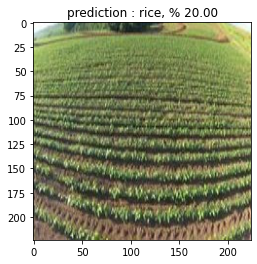

In [ ]:
ip = '/kaggle/input/agriculture-crop-images/kag2/rice/rice024ahs.jpeg'
ip = "/kaggle/input/kag2/sugarcane/sugarcane037ahs.jpeg"
data_pipeline(ip,model=best_model6)

In [ ]:
#summarize plots

## summary plot

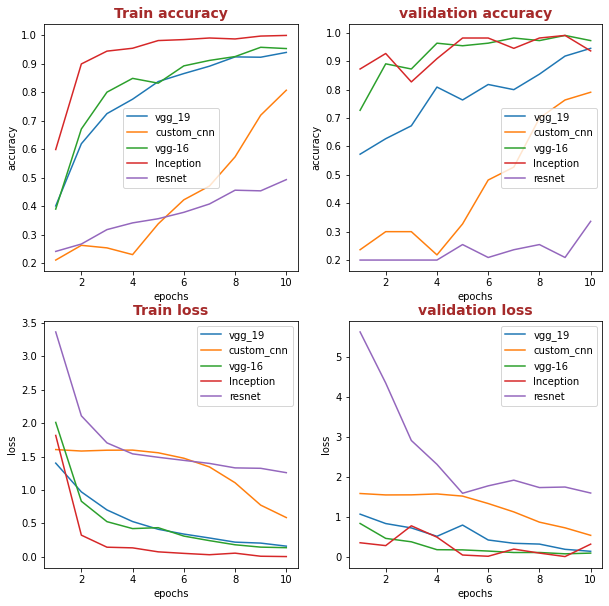

In [ ]:
e=10
plt.figure(figsize=(10,10))
row=2
col=2
plt.subplot(2,2,1)
ep =list(range(1,e+1))
plt.plot(ep,a111[:10],label="vgg_19")
plt.plot(ep,a121[:e],label="custom_cnn")
plt.plot(ep,a131[:e],label="vgg-16")
plt.plot(ep,a141[:e],label="Inception")
plt.plot(ep,a151[:e],label="resnet")
#plt.plot(ep,a161[:e],label="effectivenet")
plt.xlabel("epochs")
plt.ylabel("accuracy")
plt.title('Train accuracy',fontweight = 'bold',fontsize=14, color = 'brown')
plt.legend()

plt.subplot(2,2,2)
plt.plot(ep,a112[:10],label="vgg_19")
plt.plot(ep,a122[:e],label="custom_cnn")
plt.plot(ep,a132[:e],label="vgg-16")
plt.plot(ep,a142[:e],label="Inception")
plt.plot(ep,a152[:e],label="resnet")
plt.xlabel("epochs")
plt.ylabel("accuracy")
plt.title('validation accuracy',fontweight = 'bold',fontsize=14, color = 'brown')
plt.legend()

plt.subplot(2,2,3)
plt.plot(ep,l111[:10],label="vgg_19")
plt.plot(ep,l121[:e],label="custom_cnn")
plt.plot(ep,l131[:e],label="vgg-16")
plt.plot(ep,l141[:e],label="Inception")
plt.plot(ep,l151[:e],label="resnet")
#plt.plot(ep,a161[:e],label="effectivenet")
plt.xlabel("epochs")
plt.ylabel("loss")
plt.title('Train loss',fontweight = 'bold',fontsize=14, color = 'brown')
plt.legend()

plt.subplot(2,2,4)
plt.plot(ep,l112[:10],label="vgg_19")
plt.plot(ep,l122[:e],label="custom_cnn")
plt.plot(ep,l132[:e],label="vgg-16")
plt.plot(ep,l142[:e],label="Inception")
plt.plot(ep,l152[:e],label="resnet")
plt.xlabel("epochs")
plt.ylabel("loss")
plt.title('validation loss',fontweight = 'bold',fontsize=14, color = 'brown')
plt.legend()



plt.show()


In [ ]:
# Please compare all your models using Prettytable library
# http://zetcode.com/python/prettytable/
from prettytable import PrettyTable
TB = PrettyTable()
TB.title = "Image_classification" # title of the table

# mention the required column names
TB.field_names = ["Model", "Train_accuracy","Train_loss", "Test_accuracy", "Test_loss"]

# best epoch is nothing but  got the best validation accuracy so 

e1 = a112.index(max(a112))
e2 = a122.index(max(a122))
e3 = a132.index(max(a132))
e4 = a142.index(max(a142))
e5 = a152.index(max(a152))
e6 = a162.index(max(a162))

# models
M1 = "VGG-19"
M2 = "custom_CNN"
M3 = "VGG-16"
M4 = "Inception"
M5 = "Resnet"
M6 = "Efficientnet"

# training accuracy values
tr_a1 = a111[e1]  #max(a111)
tr_a2 = a121[e2]  #max(a121)
tr_a3 = a131[e3]  #max(a131)
tr_a4 = a141[e4]  #max(a141)
tr_a5 = a151[e5]  #max(a151)
tr_a6 = a161[e6]  #max(a161)

tr_a1 = np.round(tr_a1,3)
tr_a2 = np.round(tr_a2,3)
tr_a3 = np.round(tr_a3,3)
tr_a4 = np.round(tr_a4,3)
tr_a5 = np.round(tr_a5,3)
tr_a6 = np.round(tr_a6,3)

# trainingloss values
tr_l1 =  l111[e1]  #min(l111)
tr_l2 =  l121[e2]  #min(l121)
tr_l3 =  l131[e3]  #min(l131)
tr_l4 =  l141[e4]  #min(l141)
tr_l5 =  l151[e5]  #min(l151)
tr_l6 =  l161[e6]  #min(l161)

tr_l1 = np.round(tr_l1,3)
tr_l2 = np.round(tr_l2,3)
tr_l3 = np.round(tr_l3,3)
tr_l4 = np.round(tr_l4,3)
tr_l5 = np.round(tr_l5,3)
tr_l6 = np.round(tr_l6,3)



# testing accuracy values

te_a1 = a112[e1]    #max(a112)
te_a2 = a122[e2]   #max(a122)
te_a3 = a132[e3]   #max(a132)
te_a4 = a142[e4]   #max(a142)
te_a5 = a152[e5]   #max(a152)
te_a6 = a162[e6]   #max(a162)

te_a1 = np.round(te_a1,3)
te_a2 = np.round(te_a2,3)
te_a3 = np.round(te_a3,3)
te_a4 = np.round(te_a4,3)
te_a5 = np.round(te_a5,3)
te_a6 = np.round(te_a6,3)

# testing loss values
te_l1 = l112[e1]   #min(l112)
te_l2 = l122[e2]   #min(l122)
te_l3 = l132[e3]   #min(l132)
te_l4 = l142[e4]   #min(l142)
te_l5 = l152[e5]   #min(l152)
te_l6 = l162[e6]   #min(l162)

te_l1 = np.round(te_l1,3)
te_l2 = np.round(te_l2,3)
te_l3 = np.round(te_l3,3)
te_l4 = np.round(te_l4,3)
te_l5 = np.round(te_l5,3)
te_l6 = np.round(te_l6,3)



# create table
TB.add_row([M1, tr_a1 , tr_l1 , te_a1 , te_l1])
TB.add_row([M2, tr_a2 , tr_l2 , te_a2 , te_l2])
TB.add_row([M3, tr_a3 , tr_l3 , te_a3 , te_l3])
TB.add_row([M4, tr_a4 , tr_l4 , te_a4 , te_l4])
TB.add_row([M5, tr_a5 , tr_l5 , te_a5 , te_l5])
TB.add_row([M6, tr_a6 , tr_l6 , te_a6 , te_l6])

print(TB) # print the table


+------------------------------------------------------------------------+
|                          Image_classification                          |
+--------------+----------------+------------+---------------+-----------+
|    Model     | Train_accuracy | Train_loss | Test_accuracy | Test_loss |
+--------------+----------------+------------+---------------+-----------+
|    VGG-19    |     0.922      |    0.19    |     0.973     |   0.134   |
|  custom_CNN  |      0.94      |    0.18    |      0.9      |   0.491   |
|    VGG-16    |     0.958      |   0.143    |     0.991     |   0.083   |
|  Inception   |     0.998      |   0.007    |     0.991     |   0.015   |
|    Resnet    |     0.568      |   1.124    |     0.536     |   1.195   |
| Efficientnet |     0.187      |    2.22    |      0.2      |   1.609   |
+--------------+----------------+------------+---------------+-----------+


In [ ]:
# inception network gives the good result  among all the models
# vgg-16 , vgg-19, inception gives the good results than others.
# inception model gives the 0.99 accuracy and  loss also very very low.
# so I use the inception model as the best model

## final_data_pipeline

In [ ]:
# refer_metrics : https://www.kaggle.com/sohelranaccselab/crop-classification-using-efficient-net-b5


In [ ]:
def predict_crop_image(path):
  # required libraries
  import cv2 
  import pickle
  import numpy as np
  import matplotlib.pyplot as plt

  """
   this function takes image path and predict the crop type among (jute,maize,rice,sugarcane,wheat)

  """
  #predict_datagen = ImageDataGenerator(rescale=1./255)
  #pdict = {0:"jute",1:"maize",2:"rice",3:"sugarcane",4:"wheat"} # predefined the labels
  
  class_labels = ["jute","maize","rice","sugarcane","wheat"]

  # read thwe image and applying the resize and reshaping that image into channels last 
  img = cv2.imread(path) # reead the image 
  img = cv2.resize(img, (224, 224)) # resizing the given image into 224,224
  img = img/255. # scaling the image
  img = np.array(img).reshape((1, 224, 224, 3))

  # load the model
  #best_model = pickle.load(open('best_INCEPTION_model.pkl', 'rb')) # 4
  best_model = pickle.load(open('best_VGG16_model.pkl', 'rb')) # 3
  # predict the label of the given image
  Y_prediction = best_model.predict(img) # predicting the labels in the array format 1-row , 5-columns.
  y_pred = np.argmax(Y_prediction[0]) # maximum probability value among all the predicted probability of each class. in the first row 

  # plot
  plt.title("prediction : {0} % {1:.2f} : ".format(class_labels[y_pred],Y_prediction[0,y_pred]*100),fontweight = 'bold',fontsize=14, color = 'orange')
  plt.imshow(plt.imread(path)) # plot the given image
  """
  if y_pred == actual:
    print('Correct prediction')
    plt.title("prediction : {0} % {1:.2f} \ntrue        : {2}".format(class_labels[y_pred],Y_prediction[0,y_pred]*100))
  else:
    print("Messed up!!")
    print('Actual class "{0}" and predicted class "{1}"'.format(class_labels[int(y_pred)],class_labels[actual]))
  """

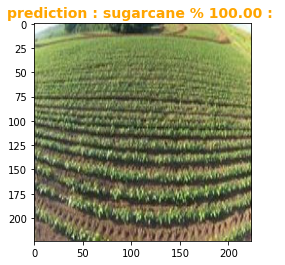

In [ ]:
#predict_crop_image(ip,3,class_label)
predict_crop_image(ip)

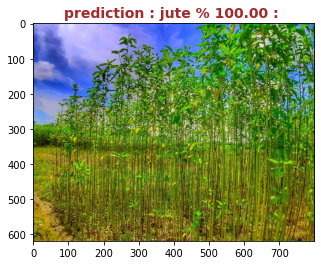

In [ ]:
predict_crop_image(img1)

### roof analysis on the model

In [ ]:
# jute
img1 = "/content/jute-field.jpg"
img2 = "/content/jute002.jpg"
img3 = "/content/jute003.jpg"
img4 =  "/content/jute03.jpg"
img5 = "/content/jutefield.jpg"
img6 = "/content/juteimg.jpg"
img7 = "/content/juteleaves.jpg"
img8 = "/content/juteplant.jpg"
img9 = "/content/juteplants.jpg"

In [ ]:
jute_image_paths = [img1,img2,img3,img4,img5,img6,img7,img8,img9]

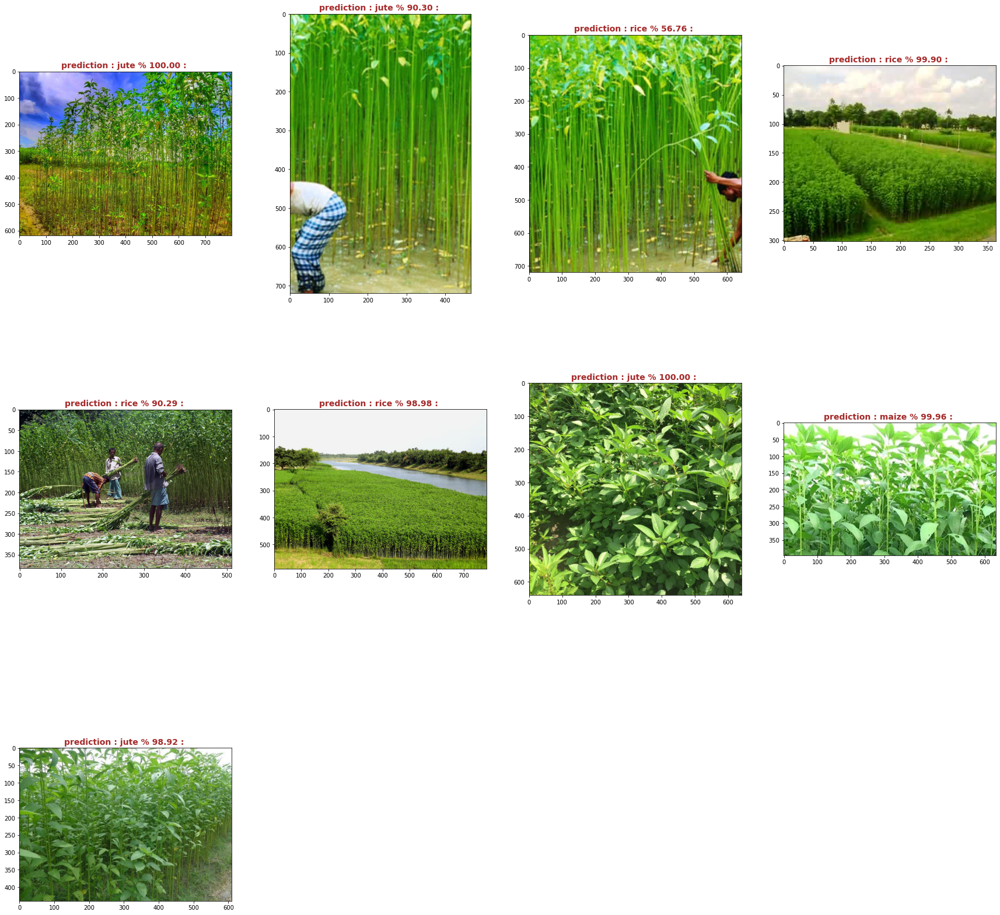

In [ ]:
#print("img{0}".format(1))
plt.figure(figsize=(30,30))
rows = 3
columns = 4
for idx,im in enumerate(jute_image_paths):
  plt.subplot(rows,columns,idx+1)
  predict_crop_image(im)
plt.show()

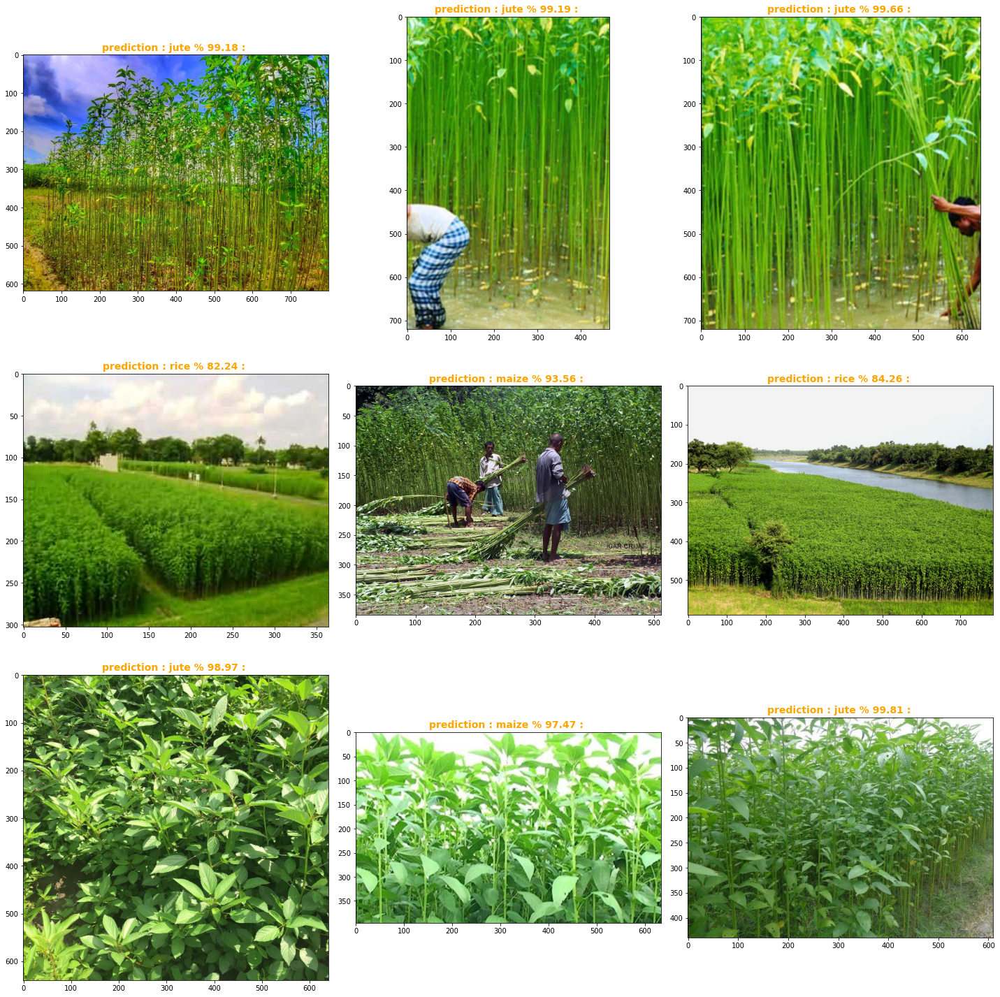

In [ ]:
#print("img{0}".format(1))
plt.figure(figsize=(20,20))
rows = 3
columns = 3
for idx,im in enumerate(jute_image_paths):
  plt.subplot(rows,columns,idx+1)
  predict_crop_image(im)
plt.tight_layout()
plt.show()

In [ ]:
# maize 
img10 = "/content/maize corn set2.jpg"
img11 = "/content/maize images.jfif"
img12 = "/content/maize plant set.jpg"
img13 = "/content/maize-Field-Corn.jpg"
img14 = "/content/maize-field.jpg"
img15 = "/content/maize-field01.jpg"
img16 = "/content/maize000.jfif"
img17 = "/content/maize00corn-fields.jpg"
img18 = "/content/maize02.jfif"
img19 = "/content/maize_fieldmexico.jpeg"
img20 = "/content/maizecornleaves.jfif"

In [ ]:
maize_image_paths = [img10,img11,img12,img13,img14,img15,img16,img17,img18,img19,img20]

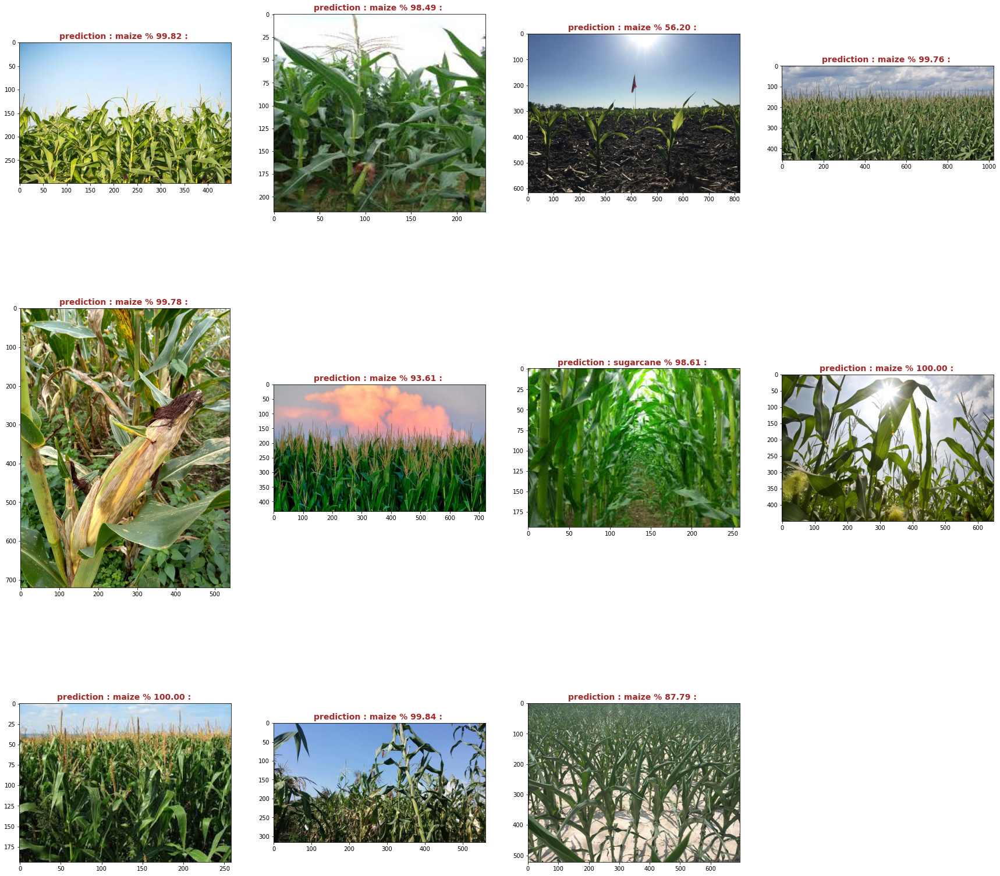

In [ ]:
#print("img{0}".format(1))
plt.figure(figsize=(30,30))
rows = 3
columns = 4
for idx,im in enumerate(maize_image_paths):
  plt.subplot(rows,columns,idx+1)
  predict_crop_image(im)
plt.show()

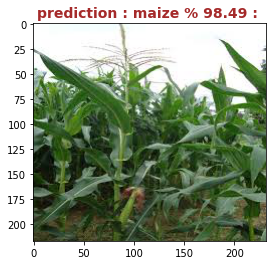

In [ ]:
predict_crop_image(img11)

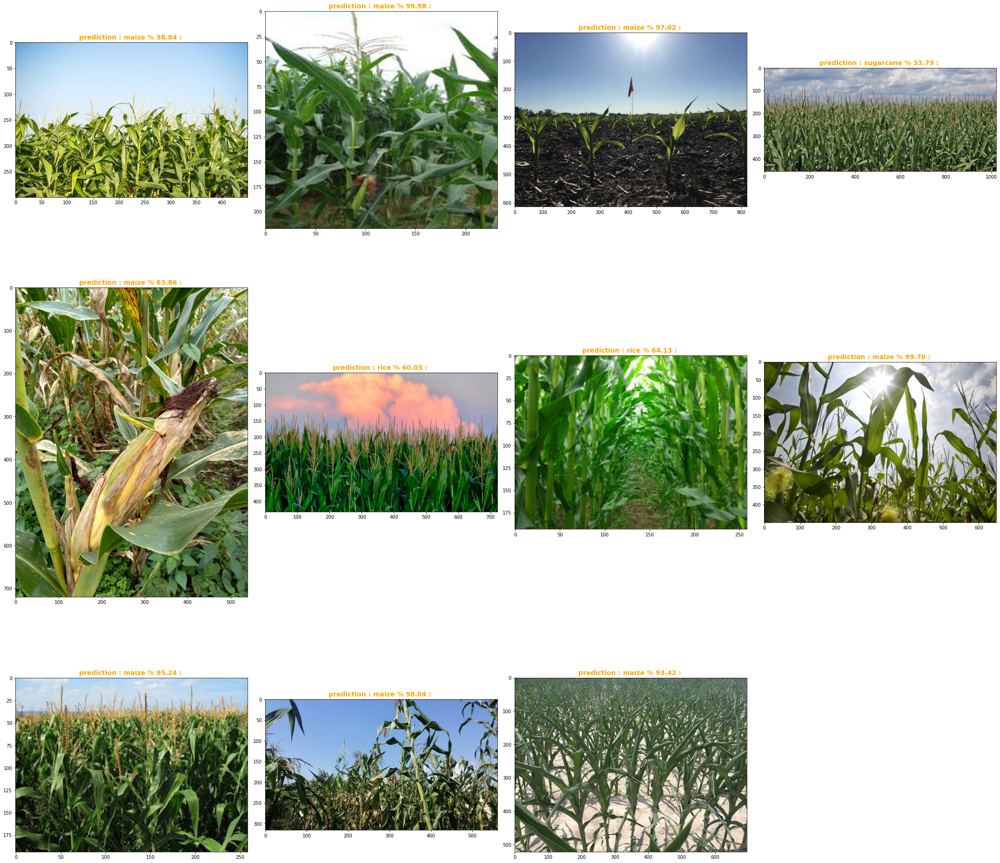

In [ ]:
#print("img{0}".format(1))
plt.figure(figsize=(30,30))
rows = 3
columns = 4
for idx,im in enumerate(maize_image_paths):
  plt.subplot(rows,columns,idx+1)
  predict_crop_image(im)
plt.tight_layout()
plt.show()

In [ ]:
#rice
img21 = "/content/rice-4967164_1280.jpg"
img22 = "/content/rice-5174887_1280.jpg"
img23 = "/content/rice-828540_1280.jpg"
img24 = "/content/rice-field.jpg"
img25 = "/content/rice-field01.jpg"
img26 = "/content/rice-field02.jpg"
img27 = "/content/rice-fields-204128_1280.jpg"
img28 = "/content/rice8122f869e3f.jpg"


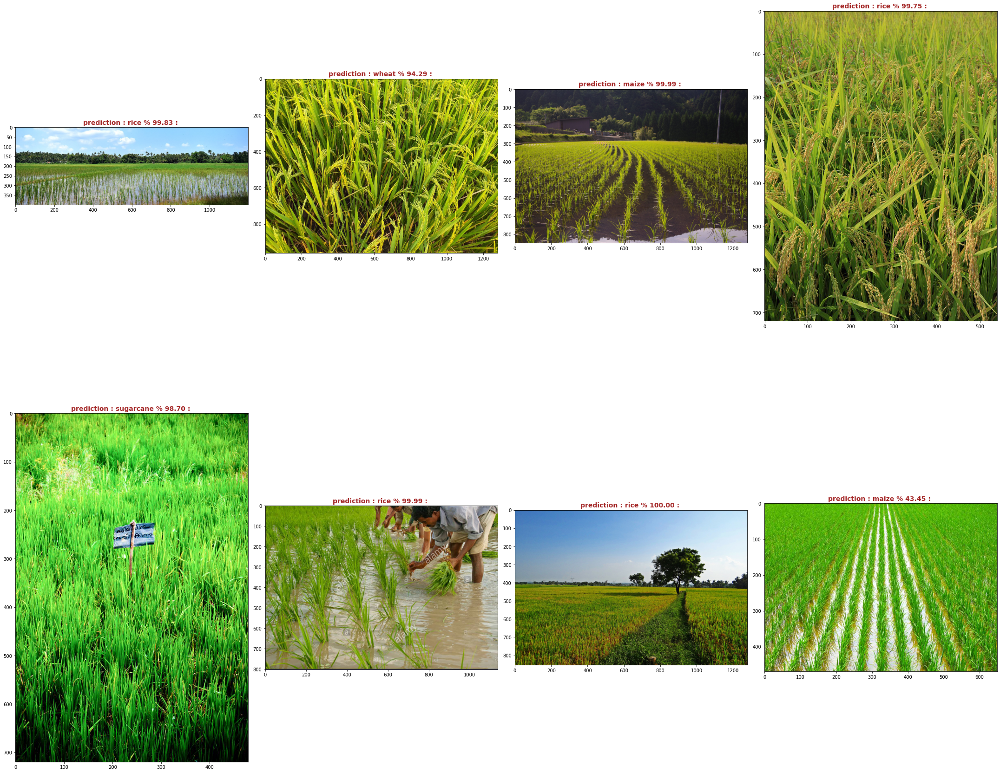

In [ ]:
rice_image_paths = [img21,img22,img23,img24,img25,img26,img27,img28]
#print("img{0}".format(1))
plt.figure(figsize=(30,30))
rows = 2
columns = 4
for idx,im in enumerate(rice_image_paths):
  plt.subplot(rows,columns,idx+1)
  predict_crop_image(im)
plt.tight_layout()
plt.show()

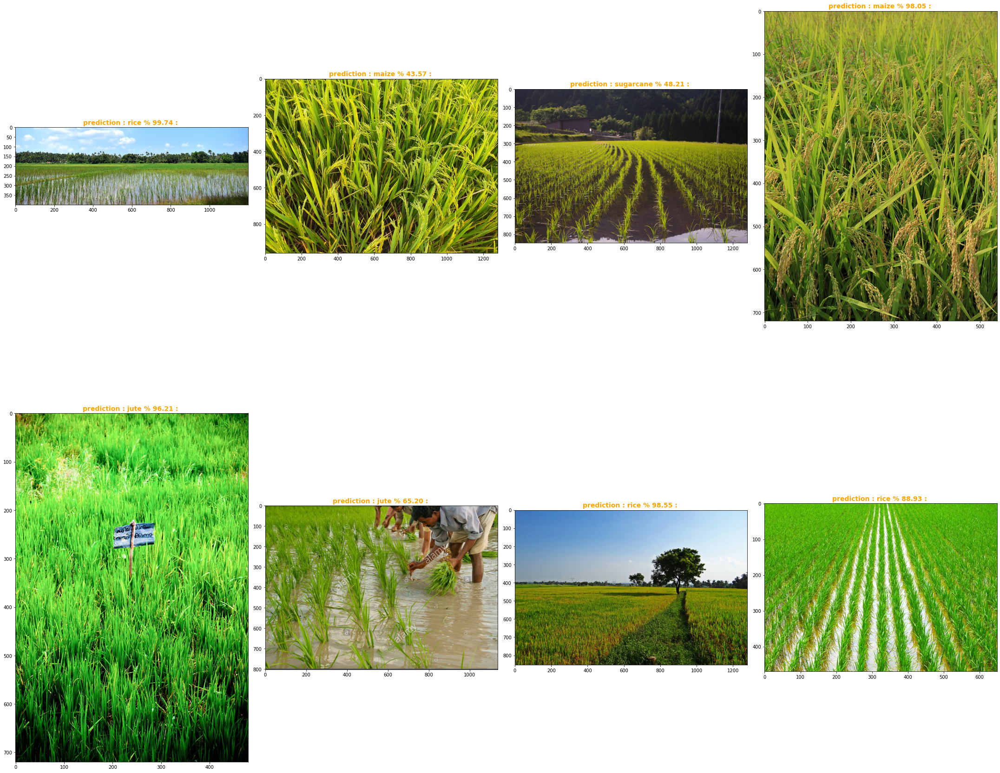

In [ ]:
rice_image_paths = [img21,img22,img23,img24,img25,img26,img27,img28]
#print("img{0}".format(1))
plt.figure(figsize=(30,30))
rows = 2
columns = 4
for idx,im in enumerate(rice_image_paths):
  plt.subplot(rows,columns,idx+1)
  predict_crop_image(im)
plt.tight_layout()
plt.show()

In [ ]:
# sugarcane
img31 = "/content/sugarcane fields.jpg"
img32 = "/content/sugarcane-farm-in-the-mountain-countryside-of-thailand.jpg"
img33 = "/content/sugarcane-field.jpg"
img34 = "/content/sugarcane-field8.jpg"
img35 = "/content/sugarcanefield.jpg"
img36 = "/content/sugarcanefield02.jpg"
img37 = "/content/sugarcaneplant.jpg"
img38 = "/content/sugarcaneplants.jpg"

In [ ]:
sugarcane_image_paths = [img31,img32,img33,img34,img35,img36,img37,img38]

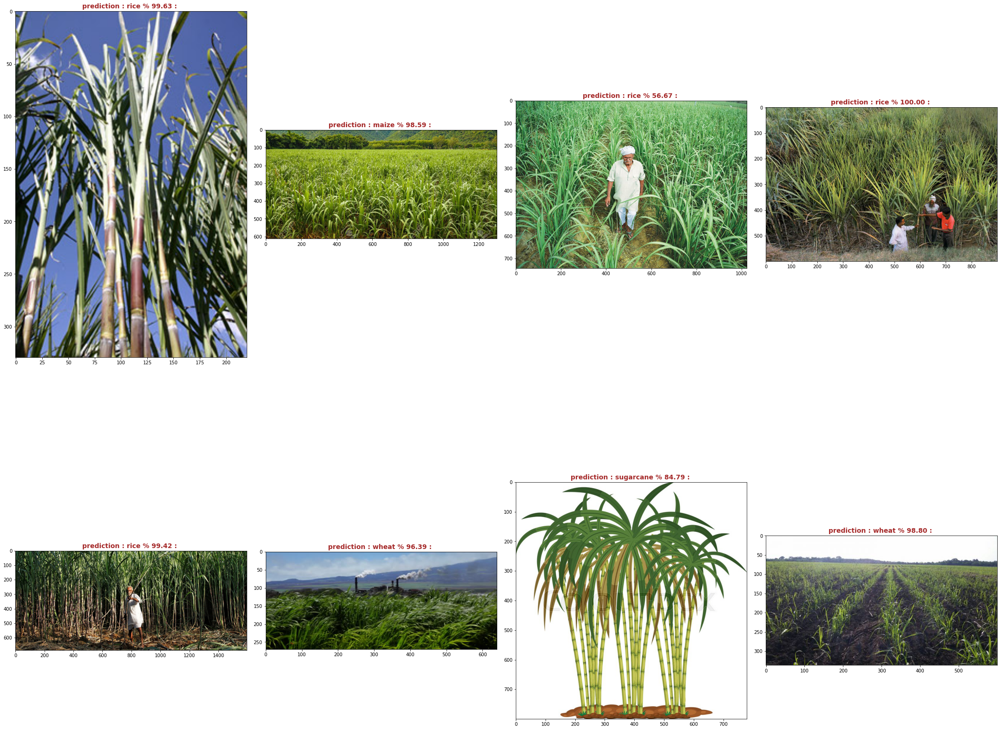

In [ ]:
#print("img{0}".format(1))
plt.figure(figsize=(30,30))
rows = 2
columns = 4
for idx,im in enumerate(sugarcane_image_paths):
  plt.subplot(rows,columns,idx+1)
  predict_crop_image(im)
plt.tight_layout()
plt.show()

In [ ]:
# wheat
img41 = "/content/wheat-crop.jpg"
img42 = "/content/wheat-field-395545_960_720.jpg"
img43 = "/content/wheat-field-artificial-irrigation-rural-electrification-to-harvest-166395991.jpg"
img44 = "/content/wheat-field.jfif"
img45 = "/content/wheat-field01.jpg"
img46 = "/content/wheat-field02.jpg"
img47 = "/content/wheat-field03.jpg"
img48 = "/content/wheat.jpg"
img49 = "/content/wheatarial02.jpg"
img50 = "/content/wheatarialview.jfif"
img51 = "/content/wheatcrop01.jpg"
img52 = "/content/wheatcropfield.jpg"
img53 = "/content/wheatcropfield04.jpg"
img54 = "/content/wheatcrops.jpg"
img55 = "/content/wheatss.jpg"

In [ ]:
wheat_image_paths = [img41,img42,img43,img44,img45,img46,img47,img48,img49,img50,img51,img52,img53,img54,img55]

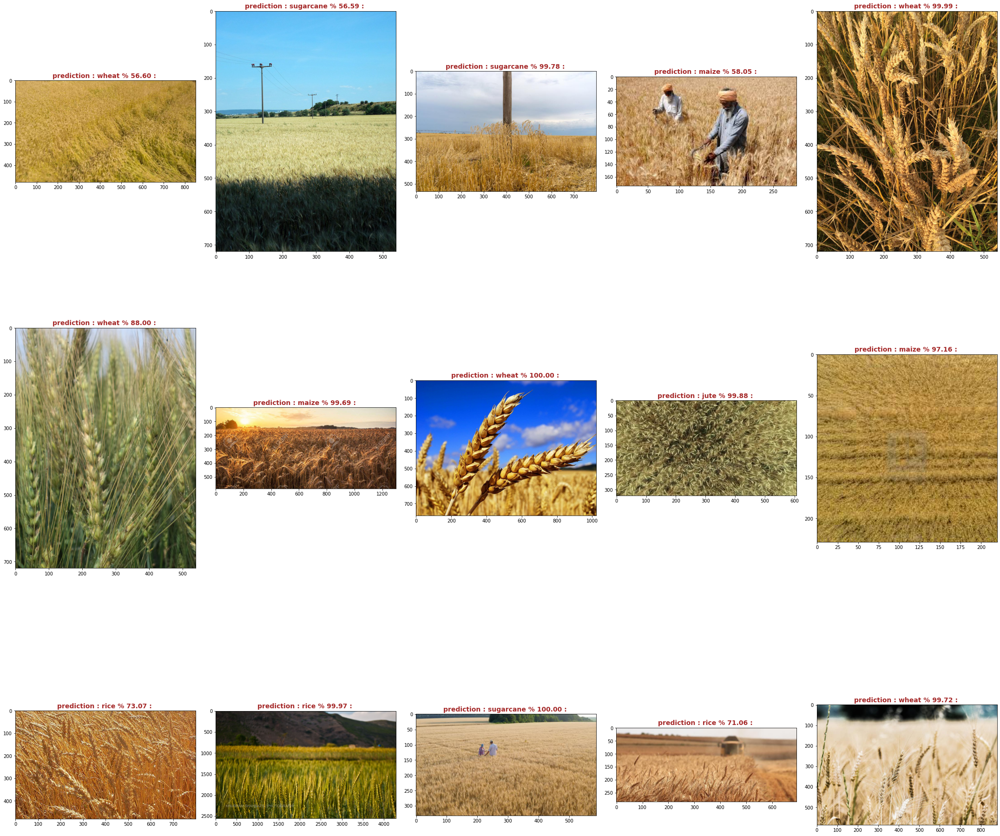

In [ ]:
#print("img{0}".format(1))
plt.figure(figsize=(30,30))
rows = 3
columns = 5
for idx,im in enumerate(wheat_image_paths):
  plt.subplot(rows,columns,idx+1)
  predict_crop_image(im)
plt.tight_layout()
plt.show()

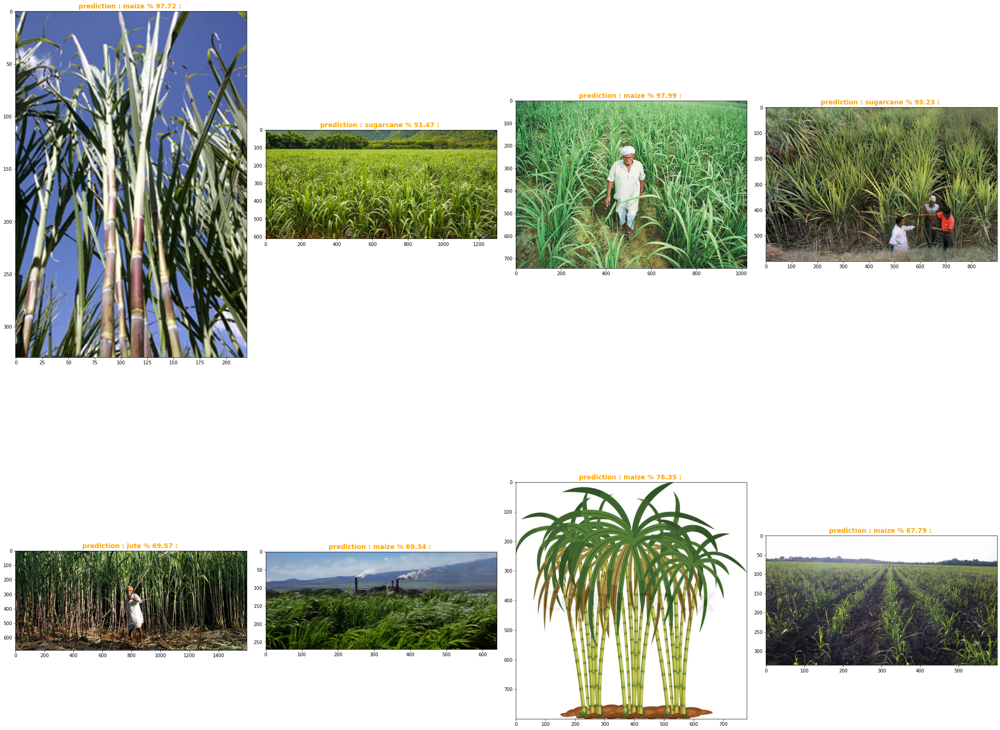

In [ ]:
#print("img{0}".format(1))
plt.figure(figsize=(30,30))
rows = 2
columns = 4
for idx,im in enumerate(sugarcane_image_paths):
  plt.subplot(rows,columns,idx+1)
  predict_crop_image(im)
plt.tight_layout()
plt.show()

In [ ]:
# single image classification
def data_pipeline(imagepath,model ,label=[-1]):
    """
    it takes the image path and the model as input and gives the label of the image
    """
    pdict = {0:"jute",1:"maize",2:"rice",3:"sugarcane",4:"wheat"} # predefined the labels
    pred_x = dataset_creation_pipeline([imagepath]) # data_pipeline model is used to generate the numpy data of the given image
    prediction = model.predict(pred_x) # by using the model predict the output.
    pred = np.argmax(prediction[0]) # take the maximum probability value
    plt.imshow(plt.imread(imagepath)) # plot the given image
    
    if (label[0]!=-1):
        plt.title("prediction : {0} % {1:.2f} \ntrue        : {2}".format(pdict[pred],prediction[0,pred]*100,pdict[np.argmax(label)]))
    else:
        plt.title("prediction : {0}, % {1:.2f}".format(pdict[pred],prediction[0,pred]*100))

100%|██████████| 1/1 [00:00<00:00, 300.56it/s]


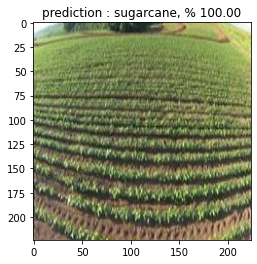

In [ ]:
data_pipeline(ip,best_model3)

In [ ]:
def data_pipeline(image)